# <center>Classificação de Maciço Rochoso a partir de dados de perfil elétrico

Este trabalho foi desenvolvido no ambito da disciplina Projeto Final do curso de especialiação BI-Master da PUC-RIO coordenador pelo ICA (Instituto de Computação Aplicada).
Aluno: Thiago da Cruz Falcão
Professor: Leonardo Mendoza
Turma: 2019.3

# Resumo

A classificação de maciços rochosos é um tema da mecânica de rochas de extrema relevância para as atividades de geologia de engenharia tais como analise de estabilidade de taludes, perfuração de túneis, assentamento de fundações de grandes estruturas como barragens hidrelétricas, perfuração de poços de petróleo, entre outros.

Este trabalho tem como objetivo buscar uma alternativa para a classificação de rochas intactas propostas por Deere & miller, 1966. Onde a partir da correlação de valores das propriedades mecânicas UCS (Unconfined Compressive Strength) e E (Young's Modulus), em um gráfico bi-dimensional, os autores classificam as amostras em 15 classes diferentes. Tal classificação é feita de forma manual e não leva em conta outras propriedades intrínsecas do material que por ventura possa ser utilizada para uma melhor discretização dos grupos, fazendo com que possamos aplicar técnicas de aprendizado de máquina na tentativa de automatizar o processo de classificação e também incluir outros parâmetros que de forma manual tornam-se bastante trabalhosa a sua análise.

Para atacar o problema, foram utilizados dados de perfis elétricos que medem propriedades intrínsecas do maciço, tais como radioatividade, densidade, velocidade e porosidade. Estas propriedades foram transformadas em propriedades mecânicas através de fórmulas empíricas coletadas da literatura, em seguida foi seguido um fluxo de trabalho de análise exploratória dos dados de forma a prepara-lo para a utilização de métodos não supervisionados de aprendizado de máquina para a identificação de clusters e a classificação automática.

No primeiro momento, foram utilizados somente as propriedades de UCS e E, de tal forma que o método pudesse replicar de alguma forma a classificação de Deere & Miller, 1966.
Foram utilizados os métodos K-means, DBSCAN, Agglomerative Hierarchy, Meansshift, TSN-e e PCA através da biblioteca Scikit Learn.

Os primeiros resultados mostraram que o k-means é o método mais rápido e que melhor se ajusta a classificação manual de Deere & Miller, quando utilizamos apenas duas propriedades. Contudo este trabalho ainda carece de uma alternativa para mensuração da acurácia e/ou de qual método de fato representa grupos distintos do comportamento do maciço rochoso.
Os resultados com TSN-e e PCA, utilizando o dado RAW (perfis) mais os perfis secundários (Propriedades Mecânicas), mostraram um resultado interessante principalmente quando visualizados no gráfico 3D (UCS, E, VpVs). Em ambos os casos, as melhores reduções foram para 3 componentes, e para o TSNe, os melhores valores de perplexidade de no mínimo 50, pois os valores menores resultam em uma nuvem mais aglutinada.
Portanto, foi visualizado que a classificação tradicional de Deere&Miller, 1966. mostra uma quantidade de classes ainda muito grande para o dataset utilizado, sendo a metodologia pca/TSN-e + K-means desenvolvida por esse trabalho sugere trabalharmos com 5 classes o que pode ser um indicativo de simplificação e consequentemente possibilitar um entendimento do comportamento do maciço de forma rápida e intuitiva.

Contudo, para um melhor entendimento do comportamento de cada classe, este trabalho sugere correlacionar a classificação automática de classes, com uma propriedades medias de cada classe com uma simulação numérica que permita compreender os mecanismos de deformação do material predominantes em cada classe, para uma mesma condição de carga.</div>

## Introdução

## Metodologia
<img src="Rock_Class_Worksflow.png" width=400 height=400 />

## Carregar Dataset
(Load Log Curves)

Principais dados utilizados são oriundos de arquivos .LAS (LOG ASCII Standard) usados para arquivos de poços publicados pela Canadian Well Logging Society (https://www.cwls.org/).

Para trabalhar com estes arquivos, uma das diversas opções exixtentes em python, optamos por trabalhar nosso dataset no formato **Pandas.DataFrame**.

O Dataset é composto por 11 arquivos, contendo Logs de 11 poços.
Os arquivos já foram transformados no formato CSV por poço, utlizando o pacote:

LASIO (https://lasio.readthedocs.io/en/latest/)

Para facilitar o trabalho foi gerado um modulo contendo diversas funções customisadas para seguir o fluxo proposto.

Módulo **calc_mec_facies**



In [1]:
# importando arquivos em um mesmo DataFrame
# Exemplo D:\BI_MASTER_PUC\PROJETO_FINAL\Projeto_Final_BIMaster\Exported_Logs
# zero lines of header

import rock_mec_facies.get_data as get_data

In [2]:
df = get_data.get_df()

Insert file folder:
->D:\BI_MASTER_PUC\PROJETO_FINAL\Projeto_Final_BIMaster\Exported_Logs
Insert how many header lines the file have:
->0
['Well_1.txt', 'Well_10.txt', 'Well_11.txt', 'Well_2.txt', 'Well_3.txt', 'Well_4.txt', 'Well_5.txt', 'Well_6.txt', 'Well_7.txt', 'Well_8.txt', 'Well_9.txt']


In [3]:
df.head()

,MD,DTCO,GR,RHOB,PHIE,PHI_ALT,DTS,WELL
0,2289.9624,NaN,NaN,NaN,NaN,NaN,NaN,Well_1
1,2290.1624,NaN,NaN,NaN,NaN,NaN,NaN,Well_1
2,2290.3624,NaN,NaN,NaN,NaN,NaN,NaN,Well_1
3,2290.5624,NaN,NaN,NaN,NaN,NaN,NaN,Well_1
4,2290.7624,NaN,NaN,NaN,NaN,NaN,NaN,Well_1


### AED Preliminar

In [5]:
#analisar o dado
df.shape

(140607, 8)

Dataset:
11 poços
140607 linhas

Curvas:
MD -> Profundidade Medida (posicionamento na vertical a partir da mesa rotativa da sonda)<br/>
GR -> Gamma Ray<br/>
Rhob -> Densidade<br/>
DTCO -> Tempo de Transito Compressional<br/>
DTS -> Tempo de Transito Cisalhante<br/>
PHIE -> Porosidade Efetiva<br/>
PHI_ALT -> Porosidade Alternativa<br/>
WELL -> Indicação de qual dado o poço pertence.<br/>

In [6]:
#reodenando as colunas
df=df[["MD","GR","RHOB","DTCO","DTS","PHIE","PHI_ALT","WELL"]]

In [7]:
# Verificar missing values
df.isnull().sum()

MD              0
GR         105919
RHOB        93003
DTCO        56204
DTS         58236
PHIE        96106
PHI_ALT     86853
WELL            0
dtype: int64

In [8]:
df.describe()

,MD,GR,RHOB,DTCO,DTS,PHIE,PHI_ALT
count,140607.000000,34688.000000,47604.000000,84403.000000,82371.000000,44501.000000,53754.000000
mean,4413.754238,3.964053,2.400285,63.911638,123.933608,0.070672,-0.091069
std,1068.083252,194.562872,0.406346,14.623225,25.384129,0.069379,0.155996
min,2224.887700,-999.000000,0.000000,0.000000,41.051300,0.000000,-0.464703
25%,3565.293150,24.913442,2.094698,62.723986,115.167347,0.004251,-0.225165
50%,4479.887700,35.408558,2.462218,67.400177,119.409897,0.054524,-0.048619
75%,5335.348215,50.516148,2.575778,68.373856,124.517937,0.122151,0.011157
max,6833.287700,374.670013,4.868548,125.987419,339.500885,0.785761,1.144510


In [9]:
# Vamos deixar o DataFrame Original para futuras modificações.
df_original = df.copy()

<AxesSubplot:xlabel='PHI_ALT'>

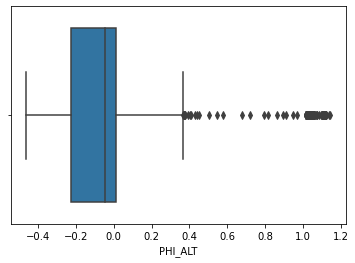

In [10]:
# Reparem que a coluna Phi_alt está com valores muito discrepantes do convencional para valores de porosidade (0-0.75).
# Vamos retira-la das futuras análises.
# 
import seaborn as sb
import matplotlib.pyplot as plt
#sb.set()

phi_alt = df["PHI_ALT"]

sb.boxplot(x=phi_alt)


In [11]:
# Vamos agora tirar os valores nulos
df.drop("PHI_ALT",axis=1,inplace=True)
df.head()

,MD,GR,RHOB,DTCO,DTS,PHIE,WELL
0,2289.9624,NaN,NaN,NaN,NaN,NaN,Well_1
1,2290.1624,NaN,NaN,NaN,NaN,NaN,Well_1
2,2290.3624,NaN,NaN,NaN,NaN,NaN,Well_1
3,2290.5624,NaN,NaN,NaN,NaN,NaN,Well_1
4,2290.7624,NaN,NaN,NaN,NaN,NaN,Well_1


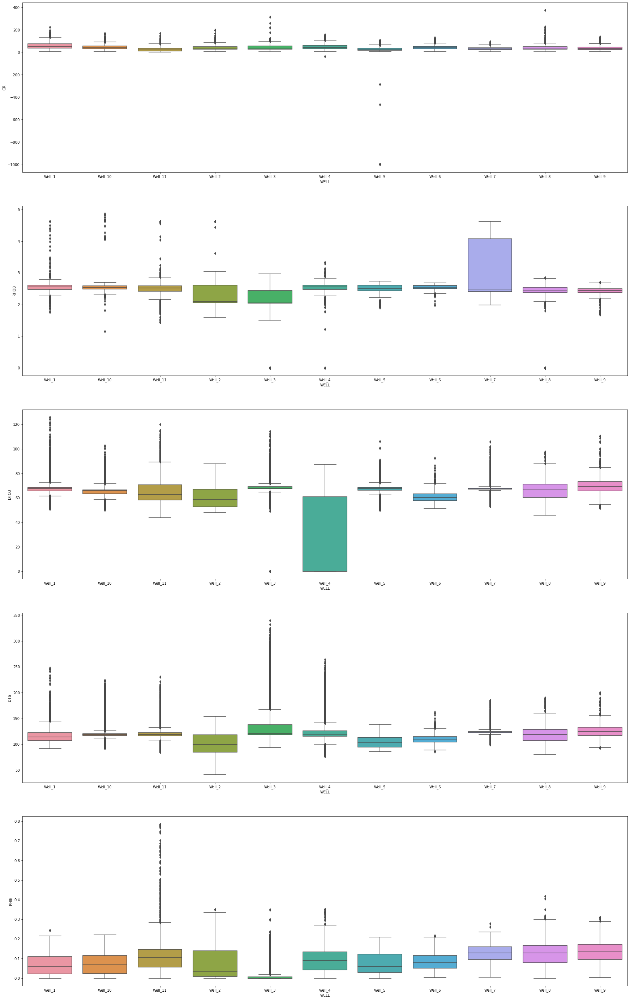

In [12]:
# boxplot for all curves
# Sobraram as curvas GR, Rhob, DTCO, DTS, PHIE
curves = ["GR","RHOB","DTCO","DTS","PHIE"]

fig,axes = plt.subplots(figsize=(30,50),nrows=len(curves))
n=0
for i in curves:
    sb.boxplot(x="WELL",y=i,data=df,ax=axes[n])
    n=n+1

In [13]:
# antes de tratar caso a caso, vamos retirar da tabela os valores nulos e ver o comportamento.
# Como para o prazo senguinte precisaremos ver as relações entre cada variável, 
df_NA = df.dropna(axis=0,how="any")

In [14]:
df_NA.describe()

,MD,GR,RHOB,DTCO,DTS,PHIE
count,30219.000000,30219.000000,30219.000000,30219.000000,30219.000000,30219.000000
mean,5627.490423,41.779615,2.509316,64.495969,116.194272,0.091529
std,270.201730,23.759758,0.201510,8.420734,18.080341,0.066393
min,5033.095500,0.000000,0.000000,44.297054,41.051300,0.000000
25%,5433.978000,26.783383,2.439931,58.545212,104.422600,0.036026
50%,5604.134030,37.087681,2.524096,63.408260,114.288841,0.086233
75%,5801.442300,52.248978,2.599651,69.102760,125.422852,0.135142
max,6427.887700,313.594788,4.628800,125.987419,248.045502,0.785761


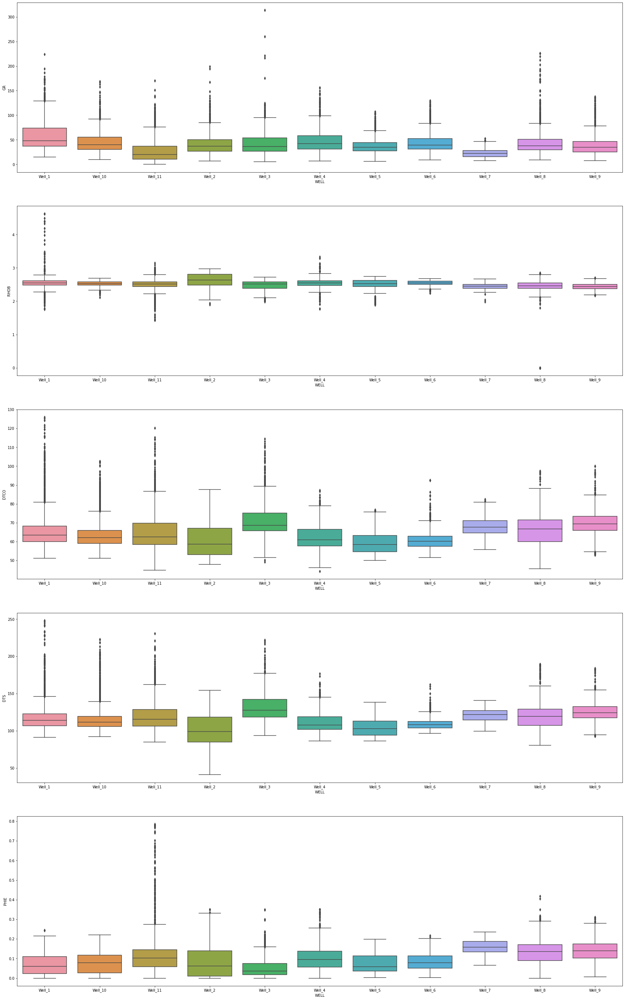

In [15]:
fig,axes = plt.subplots(figsize=(30,50),nrows=len(curves))
n=0
for i in curves:
    sb.boxplot(x="WELL",y=i,data=df_NA,ax=axes[n])
    n=n+1

Após retirada dos valores nulos, o dataset reduz para um total de 30219 linhas.<br/>
<p/>Desta forma conseguimos visualizar que a maioria dos parametros estão dentro de um range aceitável de valores:<br/>
- Gamma Ray: 0-200<br/>
- Rhob: 2-3<br/>
- DTCO: 40-140<br/>
- DTS: 60-200<br/>
- Phie: 0-0.7<br/>
<br/>
Mesmo assim, percebemos que existem alguns pontos que merecem atenção:<br/>
- Valores de **GR** acima de 200 nos poços 1, 3 e 8;<br/>
- Valores altos de **Densidade** muito altos (acima de 3.5) no poço 01, e valores baixos no poço 11;<br/>
- Para os valores de **DTCO** e **DTS**, apenas o poço 01, apresenta alguns vcalores acima do padrão mas seguem a mesma tendencia com a densidade.<br/>
- Para a Porosidade (PHIe), somente o poço 11 parece ter um série de outliers fora do padrão.<br/>
<br/>
Parte dessas dúvidas poderiam ser solucionadas, se tivessemos também o perfil de caliper e verificar se os intervalos que apresentam valores fora do padrão coincidem com os intervalos descentralizados, por exemplo.<br/>
Para os valores altos de densidade, ou são formações ricas minerais ferro magnesianos, como rochas igneas básicas, ou zonas que tivemos algum problema de perfuração onde foi necessário adensar a lama de perfuração.

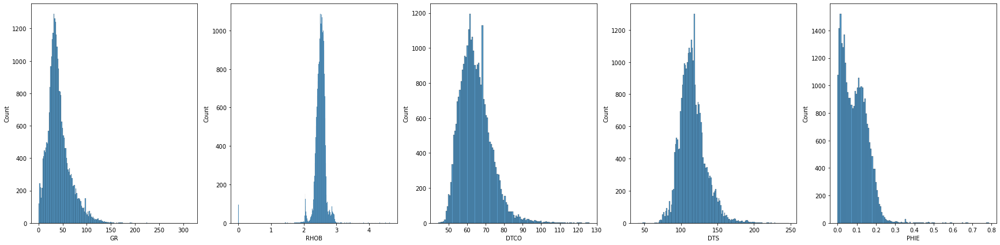

In [16]:
#Além do boxplot, vamos exergar os histogramas:
from math import ceil
fig,axes = plt.subplots(figsize=(30,7),ncols=5)
n=0
for i in curves:
    sb.histplot(data=df_NA,x=i,ax=axes[n])
    n=n+1


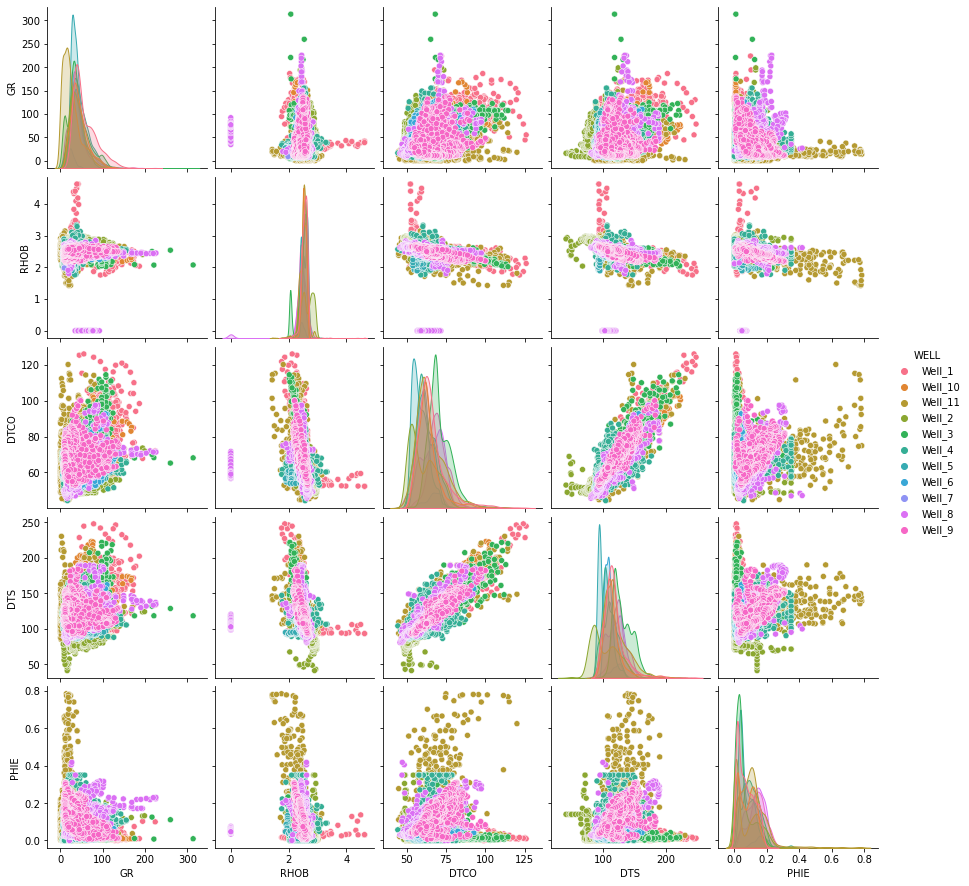

In [17]:
# matriz de correlação
sb.pairplot(df_NA,vars=curves,hue="WELL")

Este visualização nos mostra que os dados não são facilmente correlacionáveis entre si quando utilizamos eixos lineares. Apenas possuem correlação visivel o par DTCP e DTS.<br/>
Os histogramas, como mostrado acima, corroboram que majoritariamente os dados estão dentro de um range aceitável.,br/>
Portanto, vamos apenas retirar as linhas com valores de densidade proximo de zero.E para verificar se este problema está distribuido no poço ou está relacionado a um determinado intervalo, vamos plotar as curvas (variáveis) em função da profundidade.

In [18]:
def log_plot(logs):
    logs = logs.sort_values(by='MD')
    top = logs.MD.min()
    bot = logs.MD.max()
    
    f, ax = plt.subplots(nrows=1, ncols=5, figsize=(30,60))
    ax[0].plot(logs.GR, logs.MD, color='green')
    ax[1].plot(logs.RHOB, logs.MD, color='red')
    ax[2].plot(logs.PHIE, logs.MD, color='blue')
    ax[3].plot(logs.DTCO, logs.MD, color='y')
    ax[4].plot(logs.DTS, logs.MD, color='c')
    
    for i in range(len(ax)):
        ax[i].set_ylim(top,bot)
        ax[i].invert_yaxis()
        ax[i].grid()
        
    ax[0].set_xlabel("GR")
    ax[0].set_xlim(logs.GR.min(),logs.GR.max())
    ax[0].set_ylabel("MD(m)")
    ax[1].set_xlabel("RHOB")
    ax[1].set_xlim(logs.RHOB.min(),logs.RHOB.max())
    ax[2].set_xlabel("PHIE")
    ax[2].set_xlim(logs.PHIE.min(),logs.PHIE.max())
    ax[3].set_xlabel("DTCO")
    ax[3].set_xlim(logs.DTCO.min(),logs.DTCO.max())
    ax[4].set_xlabel("DTS")
    ax[4].set_xlim(logs.DTS.min(),logs.DTS.max())
    
    ax[1].set_yticklabels([]); ax[2].set_yticklabels([]);
    ax[3].set_yticklabels([])
    ax[4].set_yticklabels([]); 
    
    f.suptitle('Curves', fontsize=14,y=0.94)

In [19]:
well_list = df_NA.WELL.unique()

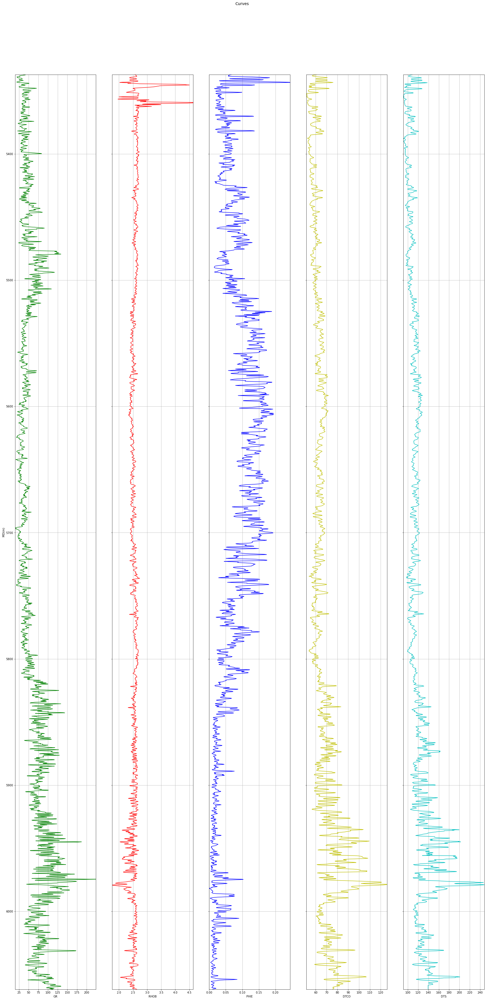

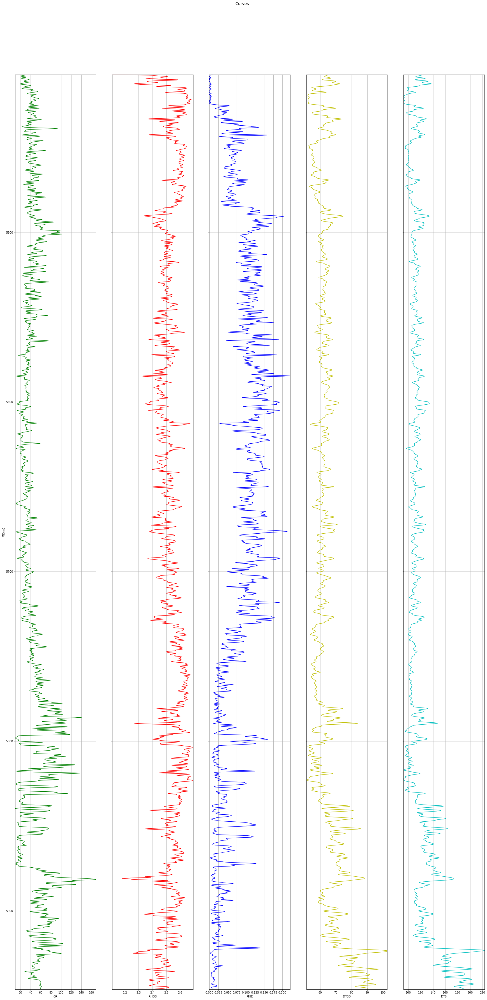

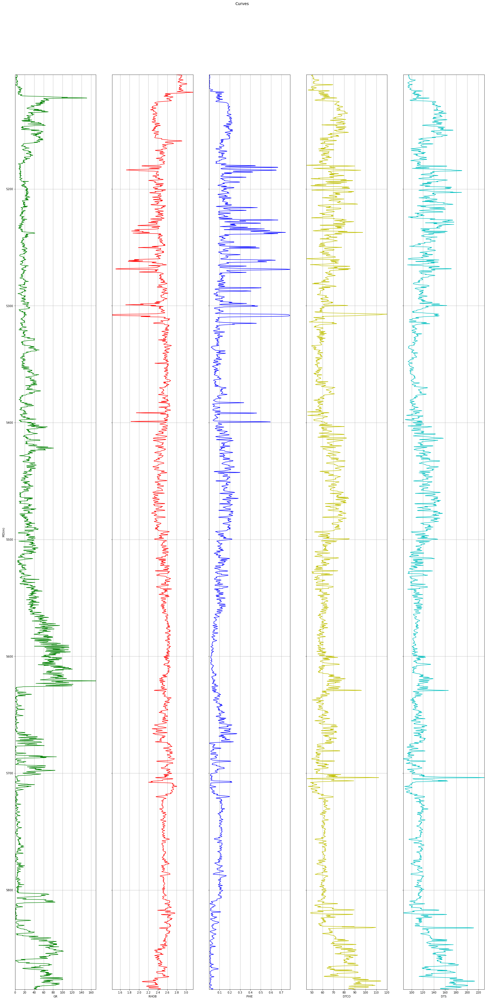

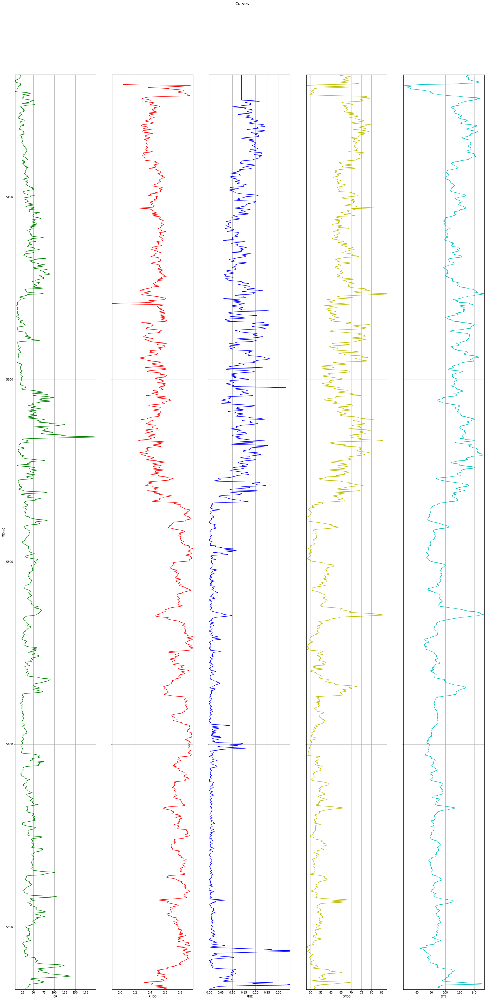

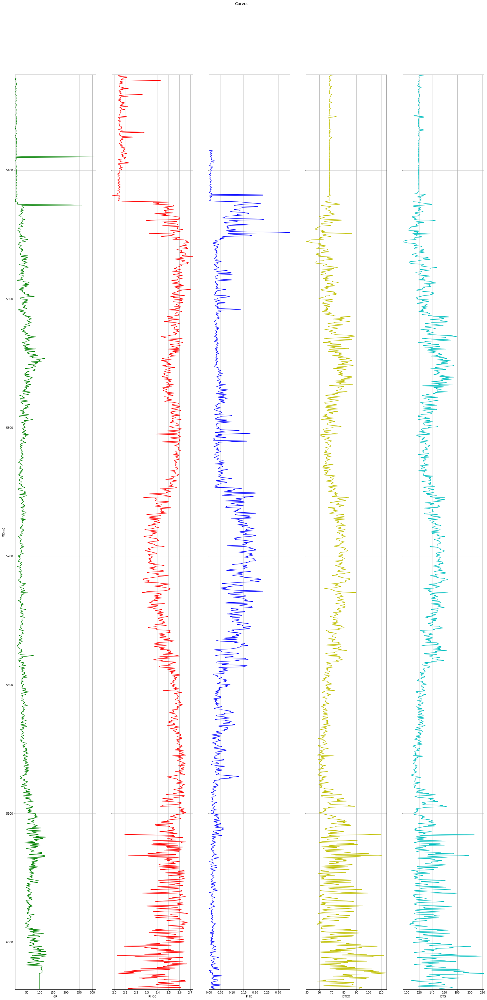

...

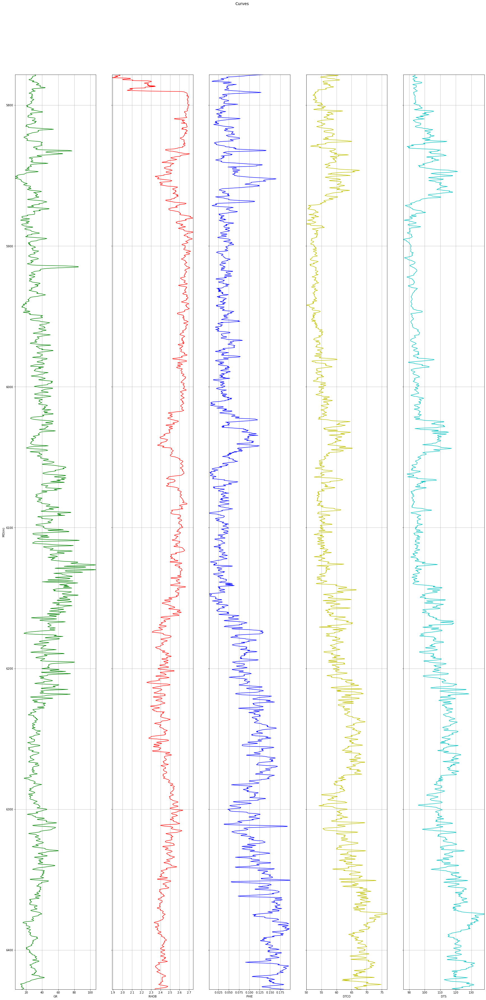

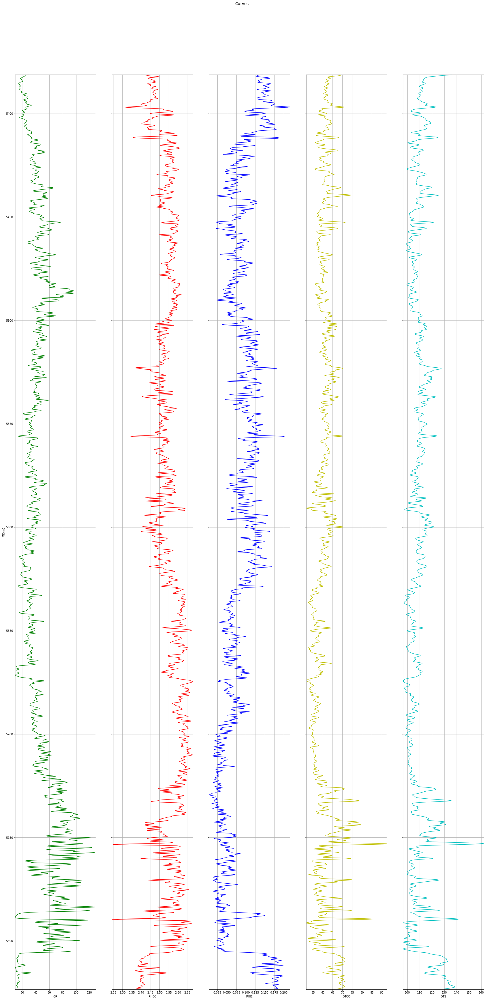

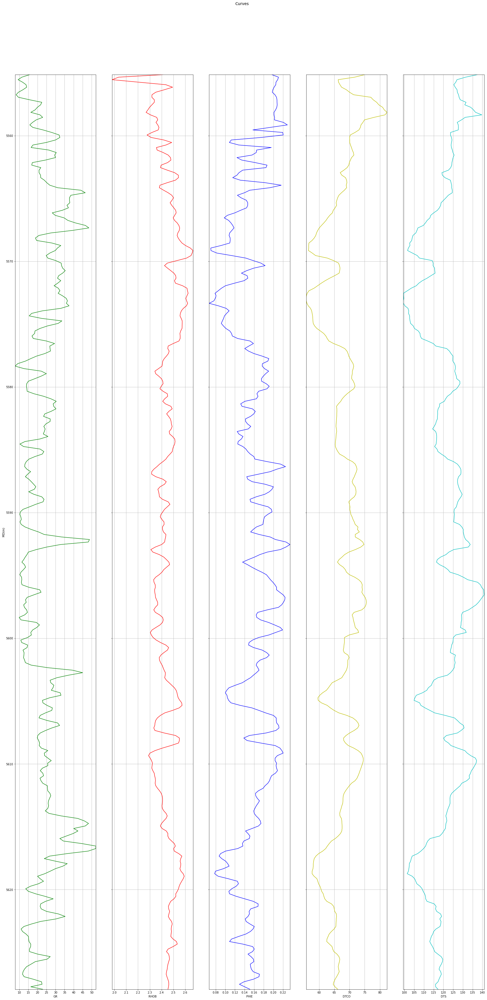

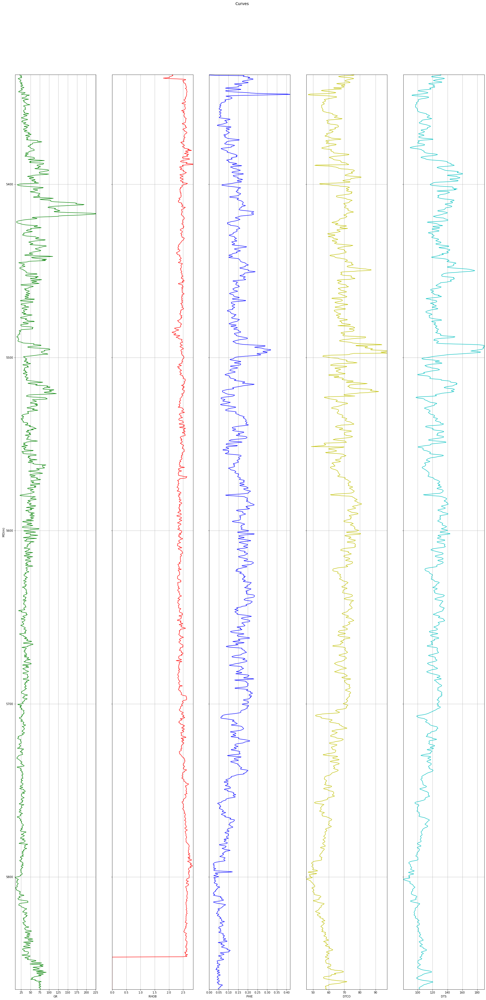

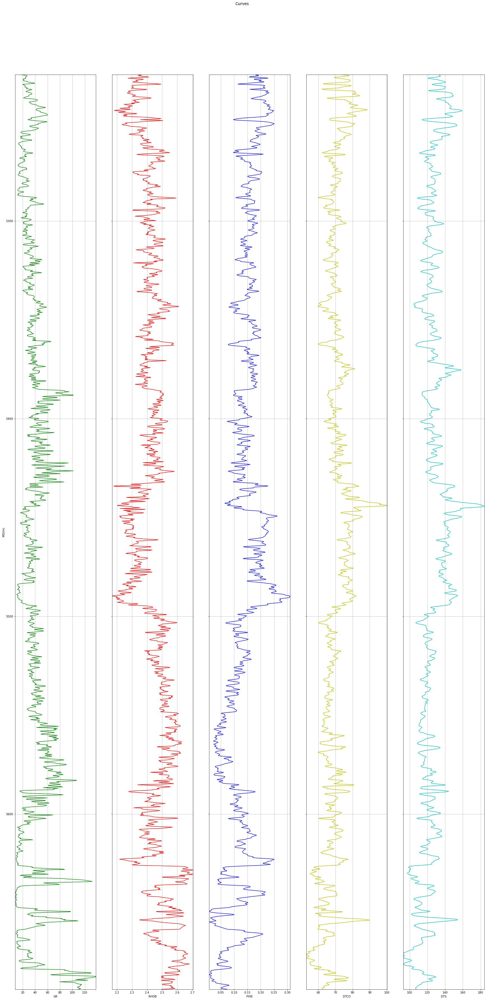

In [20]:
for well in well_list:
    log_plot(df_NA[(df_NA["WELL"]==well)])

## Calcular Propriedades Mecânicas

Como mencionado mais acima, a classificação de rochas levando em conta o comportamento das propriedades mecânicas será baseado no trabalho de Deere&Miller, 1966, cuja relatório está na pasta de referencias deste projeto.<br/>
Neste as principais propriedades levadas em conta são:
- UCS (Unconfined Compressive Strength) - Resistencia a compressão uniaxial;
- E (Young's Modulus) - Módulo de Rigidez;
- v (Poisson's Ratio) - Razão de Poisson;
<br/>
<img src="Deere_Miller_Original_Picture.png" width=400 height=400 />

Então para calcular as propriedades mecânicas, utilizaremos as funções do sub-módulo **calc_mec_prop** do módulo **rock_mec_facies**.

In [21]:
import rock_mec_facies.calc_mec_prop.young_modulus as young_modulus
import rock_mec_facies.calc_mec_prop.UCS as UCS
import rock_mec_facies.calc_mec_prop.PR as PR

Calcular curvas Vp e Vs, que são o inverso do tempo de transito DTCO e DTS, e ao mesmo tempo passamos as unidades us/ft para o SI, m/s.

In [22]:
df_NA_mec = df_NA.copy()

In [23]:
df_NA_mec["Vp"]= young_modulus.dt_to_V(df_NA_mec.DTCO)
df_NA_mec["Vs"]= young_modulus.dt_to_V(df_NA_mec.DTS)

In [24]:
df_NA_mec.head()

,MD,GR,RHOB,DTCO,DTS,PHIE,WELL,Vp,Vs
15236,5337.1624,36.384319,2.555471,61.273228,109.646599,0.068067,Well_1,4974.440086,2779.839988
15237,5337.3624,41.888142,2.571426,59.804676,106.818802,0.063731,Well_1,5096.591439,2853.430245
15238,5337.5624,38.038620,2.593175,58.100441,105.551498,0.061214,Well_1,5246.087549,2887.689939
15239,5337.7624,32.335922,2.615031,57.108669,103.638298,0.057806,Well_1,5337.193176,2940.997737
15240,5337.9624,28.901499,2.622700,56.841373,102.468079,0.059208,Well_1,5362.291260,2974.584906


Calcular curvas de Poisson Ratio e Youngs Módulus a partir das curvas de velocidade.

In [25]:
df_NA_mec["PR"] = PR.v_Dynamic_VpVs(df_NA_mec.Vp,df_NA_mec.Vs)

In [26]:
df_NA_mec["E"] = young_modulus.E_Dynamic_MavkoEtAl2009(df_NA_mec.RHOB,df_NA_mec.DTS,df_NA_mec.PR)

In [27]:
df_NA_mec.head()

,MD,GR,RHOB,DTCO,DTS,PHIE,WELL,Vp,Vs,PR,E
15236,5337.1624,36.384319,2.555471,61.273228,109.646599,0.068067,Well_1,4974.440086,2779.839988,0.272955,50275.154097
15237,5337.3624,41.888142,2.571426,59.804676,106.818802,0.063731,Well_1,5096.591439,2853.430245,0.271716,53251.109694
15238,5337.5624,38.038620,2.593175,58.100441,105.551498,0.061214,Well_1,5246.087549,2887.689939,0.282649,55471.599499
15239,5337.7624,32.335922,2.615031,57.108669,103.638298,0.057806,Well_1,5337.193176,2940.997737,0.281977,57993.125434
15240,5337.9624,28.901499,2.622700,56.841373,102.468079,0.059208,Well_1,5362.291260,2974.584906,0.277752,59303.156479


Calcular UCS, utilizando o perfil de porosidade.

In [28]:
df_NA_mec["UCS"]= df_NA_mec['PHIE'].apply(UCS.UCS_ChangEtAl_2006_I_Carbonato)

In [29]:
df_NA_mec.head()

,MD,GR,RHOB,DTCO,DTS,PHIE,WELL,Vp,Vs,PR,E,UCS
15236,5337.1624,36.384319,2.555471,61.273228,109.646599,0.068067,Well_1,4974.440086,2779.839988,0.272955,50275.154097,89.600269
15237,5337.3624,41.888142,2.571426,59.804676,106.818802,0.063731,Well_1,5096.591439,2853.430245,0.271716,53251.109694,92.341625
15238,5337.5624,38.038620,2.593175,58.100441,105.551498,0.061214,Well_1,5246.087549,2887.689939,0.282649,55471.599499,93.970881
15239,5337.7624,32.335922,2.615031,57.108669,103.638298,0.057806,Well_1,5337.193176,2940.997737,0.281977,57993.125434,96.223121
15240,5337.9624,28.901499,2.622700,56.841373,102.468079,0.059208,Well_1,5362.291260,2974.584906,0.277752,59303.156479,95.290366


In [30]:
df_NA_mec.describe()

,MD,GR,RHOB,DTCO,DTS,PHIE,Vp,Vs,PR,E,UCS
count,30219.000000,30219.000000,30219.000000,30219.000000,30219.000000,30219.000000,30219.000000,30219.000000,30219.000000,3.021900e+04,30219.000000
mean,5627.490423,41.779615,2.509316,64.495969,116.194272,0.091529,4800.726186,2683.723248,0.271239,4.734206e+04,83.305683
std,270.201730,23.759758,0.201510,8.420734,18.080341,0.066393,584.669787,403.909676,0.110998,2.702998e+04,32.416474
min,5033.095500,0.000000,0.000000,44.297054,41.051300,0.000000,2419.289181,1228.806803,-4.614148,-7.220832e+05,0.611028
25%,5433.978000,26.783383,2.439931,58.545212,104.422600,0.036026,4410.822358,2430.179160,0.255455,3.653468e+04,56.215267
50%,5604.134030,37.087681,2.524096,63.408260,114.288841,0.086233,4806.944684,2666.927030,0.274299,4.535584e+04,78.973095
75%,5801.442300,52.248978,2.599651,69.102760,125.422852,0.135142,5206.232767,2918.908365,0.292232,5.550033e+04,111.948738
max,6427.887700,313.594788,4.628800,125.987419,248.045502,0.785761,6880.818711,7424.856208,13.169438,2.670531e+06,143.800000


Text(0.5, 1.0, 'UCS - MPa')

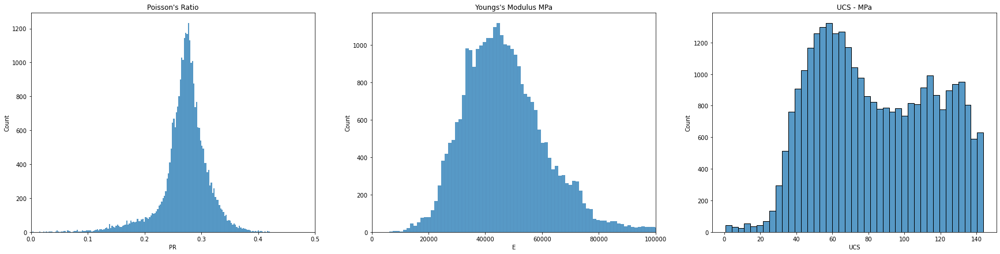

In [31]:
#plotar Histogramas
fig,axes = plt.subplots(figsize=(30,7),ncols=3)
sb.histplot(data=df_NA_mec,x="PR",ax=axes[0])
axes[0].set_xlim(0,0.5)
axes[0].set_title("Poisson's Ratio")
sb.histplot(data=df_NA_mec,x="E",ax=axes[1])
axes[1].set_xlim(0,1e5)
axes[1].set_title("Youngs's Modulus MPa")
sb.histplot(data=df_NA_mec,x="UCS",ax=axes[2])
axes[2].set_title("UCS - MPa")

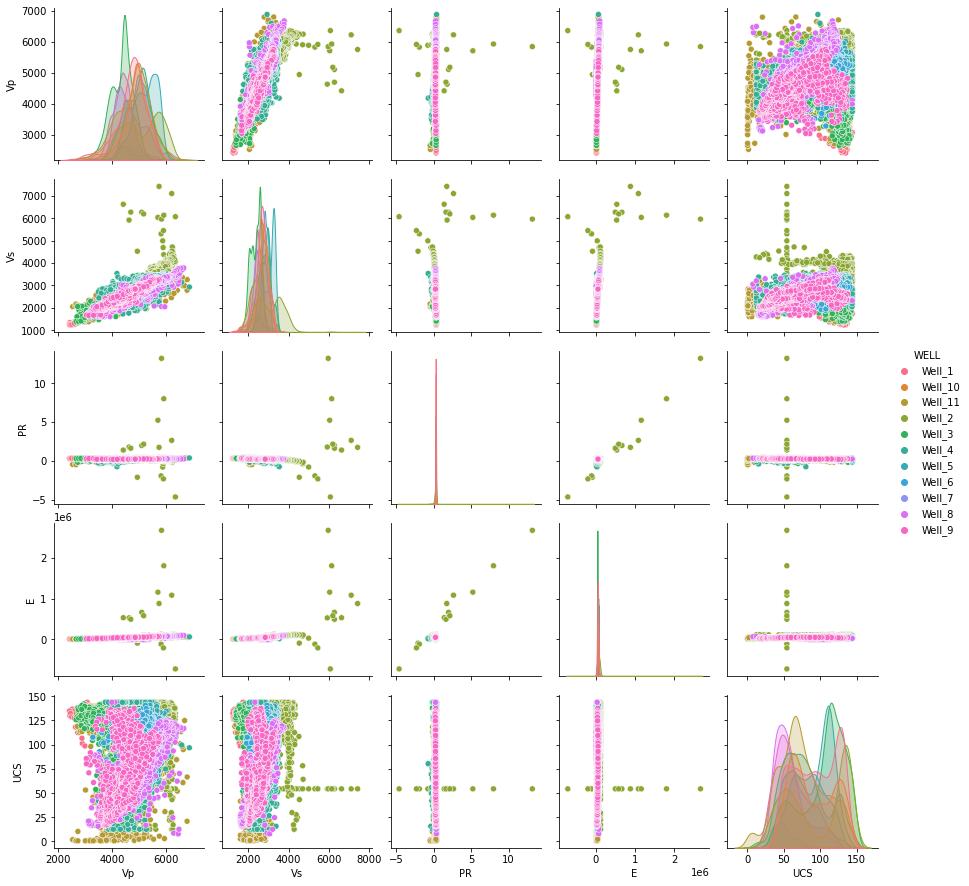

In [32]:
# observar as propriedades geradas
mec_props = ["Vp","Vs","PR","E","UCS"]
sb.pairplot(df_NA_mec,vars=mec_props,hue="WELL")

## Classificação de Rochas

### Deere&Miller, 1966

In [33]:
import rock_mec_facies.rock_class.deere_and_miller as dm

In [37]:
df_NA_mec_class = dm.class_mec_facies_deere_miller_psi(df_NA_mec)

This scripts works with ['PSI', 'Pa', 'MPa', 'GPa'].
Which one is your data using?
MPa
Dataframe in PSI units!!
              MD          GR      RHOB       DTCO         DTS      PHIE  \
15236  5337.1624   36.384319  2.555471  61.273228  109.646599  0.068067   
15237  5337.3624   41.888142  2.571426  59.804676  106.818802  0.063731   
15238  5337.5624   38.038620  2.593175  58.100441  105.551498  0.061214   
15239  5337.7624   32.335922  2.615031  57.108669  103.638298  0.057806   
15240  5337.9624   28.901499  2.622700  56.841373  102.468079  0.059208   
...          ...         ...       ...        ...         ...       ...   
2390   5687.7940  110.443283  2.559228  62.977631  107.040199  0.052187   
2391   5687.9940  110.783241  2.576521  62.462509  106.598099  0.050078   
2392   5688.1940  113.074768  2.585147  62.227333  106.583504  0.054754   
2393   5688.3940  111.525764  2.540984  62.410088  107.084000  0.062769   
2394   5688.5940  109.105804  2.496987  62.672977  107.566101  

This scripts works with ['PSI', 'Pa', 'MPa', 'GPa'].
Which one is your data using?
PSI
Dataframe in PSI units!!
              MD          GR      RHOB       DTCO         DTS      PHIE  \
15236  5337.1624   36.384319  2.555471  61.273228  109.646599  0.068067   
15237  5337.3624   41.888142  2.571426  59.804676  106.818802  0.063731   
15238  5337.5624   38.038620  2.593175  58.100441  105.551498  0.061214   
15239  5337.7624   32.335922  2.615031  57.108669  103.638298  0.057806   
15240  5337.9624   28.901499  2.622700  56.841373  102.468079  0.059208   
...          ...         ...       ...        ...         ...       ...   
2390   5687.7940  110.443283  2.559228  62.977631  107.040199  0.052187   
2391   5687.9940  110.783241  2.576521  62.462509  106.598099  0.050078   
2392   5688.1940  113.074768  2.585147  62.227333  106.583504  0.054754   
2393   5688.3940  111.525764  2.540984  62.410088  107.084000  0.062769   
2394   5688.5940  109.105804  2.496987  62.672977  107.566101  

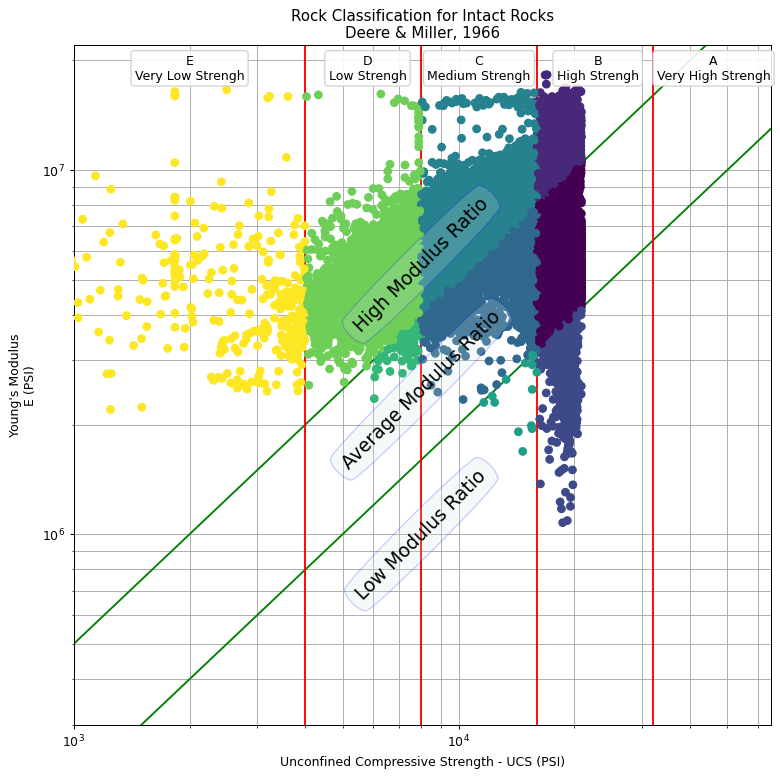

In [38]:
dm.plot_deere_miller_graph_log_psi(df_NA_mec_class)

(0.0, 150.0)

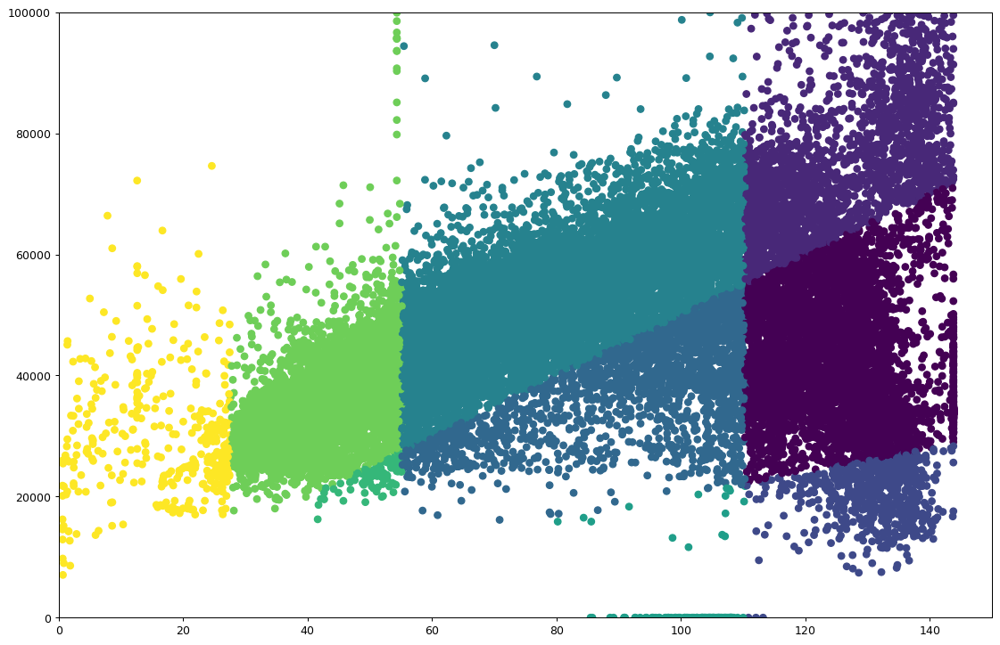

In [39]:
fig, ax = plt.subplots(figsize=(15,10),dpi=90)
ax.scatter(df_NA_mec.UCS,df_NA_mec.E,c=df_NA_mec_class["Deere_&_Miller_Class"].astype("category").cat.codes)
ax.set_ylim(0,1e5)
ax.set_xlim(0,150)

### Classificação de Rochas utilizando métodos de clusterização/ Agrupamento

</p>
A escolha do método para indentificar os grupos com comportamentos similares sem uma classificação prévia de saida pra treinar o modelo de predição nos remete aos algoritmos não supervisionados. Para este foram utilizados como material de referencia para este trabalho a biblioteca <!-- [Text](link) -->
<a href="https://scikit-learn.org/stable/tutorial/machine_learning_map/index.html" title="Optional Title">Scikit Learn</a>!</p>
</br>
<img src="ml_map.png" width=600 height=600 />

</p>
Vamos fazer um teste inicial com o K-means, um dos mais conhecidos algoritmos de clusterização conhecidos.</P>

In [40]:
# Copiar Dataframe para testes
df_NA_mec_ML = df_NA_mec.copy()
df_NA_mec_ML.head()

,MD,GR,RHOB,DTCO,DTS,PHIE,WELL,Vp,Vs,PR,E,UCS
15236,5337.1624,36.384319,2.555471,61.273228,109.646599,0.068067,Well_1,4974.440086,2779.839988,0.272955,50275.154097,89.600269
15237,5337.3624,41.888142,2.571426,59.804676,106.818802,0.063731,Well_1,5096.591439,2853.430245,0.271716,53251.109694,92.341625
15238,5337.5624,38.038620,2.593175,58.100441,105.551498,0.061214,Well_1,5246.087549,2887.689939,0.282649,55471.599499,93.970881
15239,5337.7624,32.335922,2.615031,57.108669,103.638298,0.057806,Well_1,5337.193176,2940.997737,0.281977,57993.125434,96.223121
15240,5337.9624,28.901499,2.622700,56.841373,102.468079,0.059208,Well_1,5362.291260,2974.584906,0.277752,59303.156479,95.290366


In [41]:
from sklearn.cluster import KMeans

In [42]:
# Teste inicial com 4 cluster
df_UCS_E = df_NA_mec_ML[["E","UCS"]].copy()
k_means_model = KMeans(init="k-means++",n_clusters=4,n_init=10)
k_means_model.fit(df_UCS_E)
df_UCS_E['cluster']=k_means_model.predict(df_UCS_E)

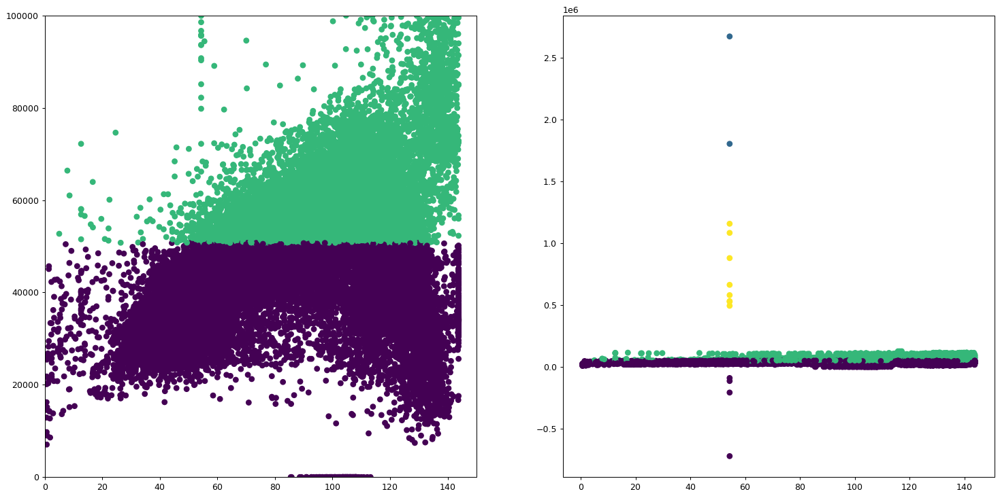

In [43]:
# Plotar 
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,10),dpi=90)
ax1.scatter(df_UCS_E.UCS,df_UCS_E.E,c=df_UCS_E["cluster"])
ax1.set_ylim(0,1e5)
ax1.set_xlim(0,150)
ax2.scatter(df_UCS_E.UCS,df_UCS_E.E,c=df_UCS_E["cluster"])


Reparemos que o resultrado acima difere muito do que obtido na classificação manual.  
O primeiro motivo é a presença de **outliers** nos valores de Modulo de Young (E).

<AxesSubplot:xlabel='UCS'>

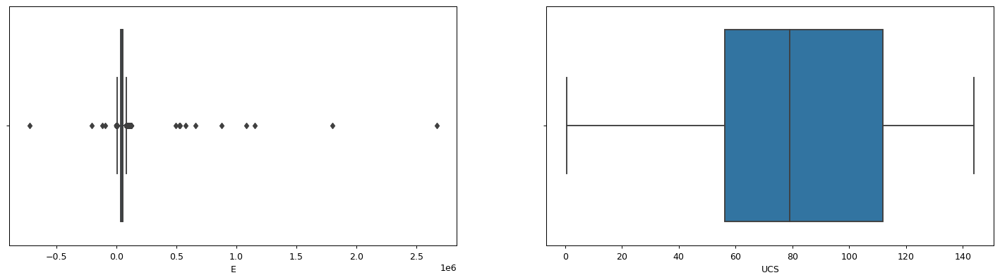

In [44]:
#Visualiar os outliers utilizando boxplots
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,5),dpi=90)
sb.boxplot(data=df_UCS_E,x="E",ax=ax1)
sb.boxplot(data=df_UCS_E,x="UCS",ax=ax2)

In [45]:
# Retirar os valores espurios, existem diversas técnicas, vamos cortar os valores abaixo de 1GPa e os maiores que 
index = df_UCS_E[(df_UCS_E["E"]<=df_UCS_E.E.quantile(0.01))|(df_UCS_E["E"]>= df_UCS_E.E.quantile(0.97))].index
df_UCS_E_clean = df_UCS_E.drop(index).copy()
df_UCS_E_clean.E.describe()

count    27631.000000
mean     45790.508598
std      12639.693933
min      17681.936851
25%      36463.903399
50%      44799.711249
75%      54124.295672
max      79559.843295
Name: E, dtype: float64

In [46]:
df_UCS_E_clean.head()

,E,UCS,cluster
15243,59137.454704,92.702123,2
15244,55841.485487,74.784382,2
15245,50565.191397,57.976112,0
15246,45241.003988,49.463883,0
15284,79002.900528,116.147559,2


<AxesSubplot:xlabel='UCS'>

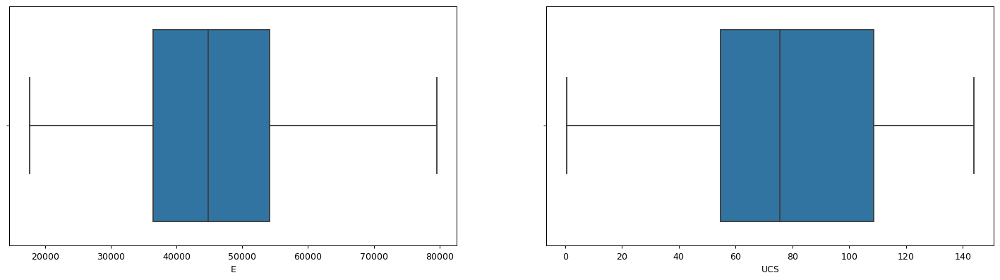

In [47]:
#Visualiar limpeza dos outliers utilizando boxplots
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,5),dpi=90)
sb.boxplot(data=df_UCS_E_clean,x="E",ax=ax1)
sb.boxplot(data=df_UCS_E_clean,x="UCS",ax=ax2)

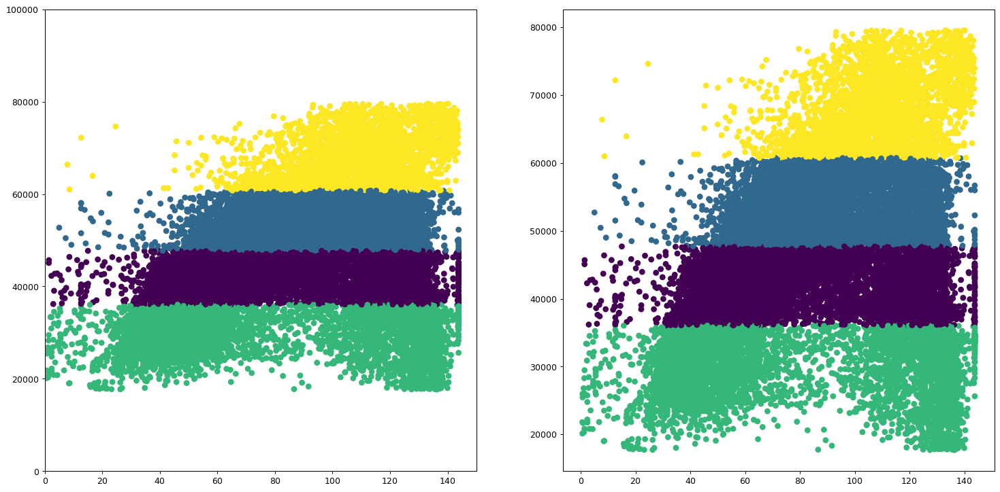

In [48]:
df_UCS_E_clean.drop("cluster",axis=1,inplace=True) 
#Repetir Classificação pelo Kmeans
k_means_model = KMeans(init="k-means++",n_clusters=4,n_init=10)
k_means_model.fit(df_UCS_E_clean)
df_UCS_E_clean['cluster']=k_means_model.predict(df_UCS_E_clean)

fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,10),dpi=90)
ax1.scatter(df_UCS_E_clean.UCS,df_UCS_E_clean.E,c=df_UCS_E_clean["cluster"])
ax1.set_ylim(0,1e5)
ax1.set_xlim(0,150)
ax2.scatter(df_UCS_E_clean.UCS,df_UCS_E_clean.E,c=df_UCS_E_clean["cluster"])

O resultado ainda não se encontra razoável, vemos que o dado ficou estratificado, poderia ser uma alternativa mas ainda difere da classificação de Deere & Miller, 1966.  
Tal resultado deve-se a métrica utilizada para identificação dos cluster que se baseia na distancia euclidiana dos pontos em relação aos centros dos clusters, o que é muito afetado pela diferença entre os min. e max. de cada dimensão do dado. Neste exemplo, os valores absolutos do E (Mod. de Young) estão muito mais altos que os valores de UCS.  
Ou seja, o Kmeans é muito afetado por dados que não estejam normalizados ou nas mesmas ordens de grandeza.

In [49]:
import pandas as pd
df_UCS_E_clean.drop("cluster",axis=1,inplace=True) 
# Teste normalizando os eixos.
#df_UCS_E_clean.drop("cluster",axis=1,inplace=True)
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df_UCS_E_clean_norm = scaler.fit_transform(df_UCS_E_clean)
df_UCS_E_clean_norm = pd.DataFrame(df_UCS_E_clean_norm,columns=["E","UCS"])

In [50]:
df_UCS_E_clean_norm.head()

,E,UCS
0,1.055974,0.378853
1,0.795206,-0.189649
2,0.377760,-0.722949
3,-0.043475,-0.993029
4,2.627674,1.122739


#### Kmeans

In [51]:
#Repetir Classificação pelo Kmeans
k_means_model = KMeans(init="k-means++",n_clusters=4,n_init=10)
k_means_model.fit(df_UCS_E_clean_norm)
df_UCS_E_clean['cluster_kmeans_4']=k_means_model.predict(df_UCS_E_clean_norm)

In [210]:
def plot_ml_classes(df,cluster):
    fig, ax = plt.subplots(figsize=(15,10),dpi=90)
    ax.set_title(cluster.upper())
    ax.scatter(df.UCS,df.E,c=df[cluster])
    ax.set_ylim(df.E.min(), df.E.max())
    ax.set_xlim(df.UCS.min(),df.UCS.max())

In [209]:
plot_ml_classes(df_UCS_E_clean,'cluster_kmeans_4')

<ipython-input-207-6fe28bc18720>:6: UserWarning: Attempting to set identical left == right == 0.6110276847026548 results in singular transformations; automatically expanding.
  ax.set_xlim(df.UCS.min(),df.UCS.min())


In [57]:
#Repetir Classificação pelo Kmeans, usando "df_UCS_E_clean", mas colocando E em GPa, ao invés de trabalhar com MPa.
#df_UCS_E_clean.drop("cluster",axis=1,inplace=True)
df_UCS_E_clean.E = df_UCS_E_clean.E /1000
k_means_model = KMeans(init="k-means++",n_clusters=4,n_init=10)
k_means_model.fit(df_UCS_E_clean)
df_UCS_E_clean['cluster_kmeans_E_GPa']=k_means_model.predict(df_UCS_E_clean)

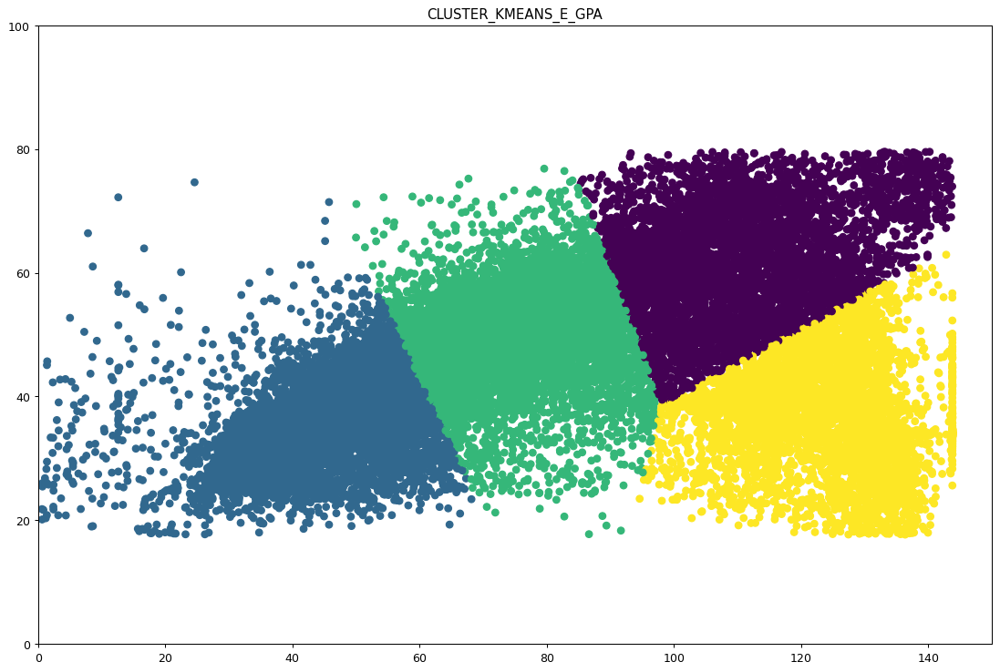

In [58]:
plot_ml_classes(df_UCS_E_clean,"cluster_kmeans_E_GPa")

##### Otimização de Clusters (Metodo do Cotovelo)

Vimos então que para usar metodos de clusterização como o kmeans, o tratamento mínimo a ser feito nas amostras é eliminar os outliers e tb normalizar o dado.  
O passo seguinte seria encontrar, o número ideal de cluster.
Para isso vamos utilizar a função **k_cluster_ideal** baseada no método do cotovelo.

In [59]:
import rock_mec_facies.rock_class.mec_facies_2d as ml_class
import matplotlib.pyplot as plt

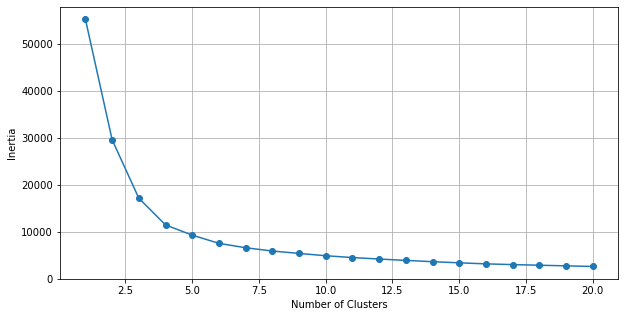

In [60]:
ml_class.k_cluster_ideal(df_UCS_E_clean_norm,20)

O gráfico acima nos mostra que o número ideal de cluster para o conjunto de dados utilizado é 4-5.  
Como com 4 cluster já calculamos, vamos então ver a diferença com 5 e 7 (número de classes obtida com a classificação manual).

In [61]:
#Repetir Classificação pelo Kmeans com 5 clusters
#df_UCS_E_clean.drop("cluster",axis=1,inplace=True)
k_means_model = KMeans(init="k-means++",n_clusters=5,n_init=10)
k_means_model.fit(df_UCS_E_clean_norm)
df_UCS_E_clean['cluster_kmeans_5']=k_means_model.predict(df_UCS_E_clean_norm)

In [208]:
plot_ml_classes(df_UCS_E_clean,"cluster_kmeans_5")

<ipython-input-207-6fe28bc18720>:6: UserWarning: Attempting to set identical left == right == 0.6110276847026548 results in singular transformations; automatically expanding.
  ax.set_xlim(df.UCS.min(),df.UCS.min())


In [63]:
#Repetir Classificação pelo Kmeans com 7 clusters
#df_UCS_E_clean.drop("cluster",axis=1,inplace=True)
k_means_model = KMeans(init="k-means++",n_clusters=7,n_init=10)
k_means_model.fit(df_UCS_E_clean_norm)
df_UCS_E_clean['cluster_kmeans_7']=k_means_model.predict(df_UCS_E_clean_norm)

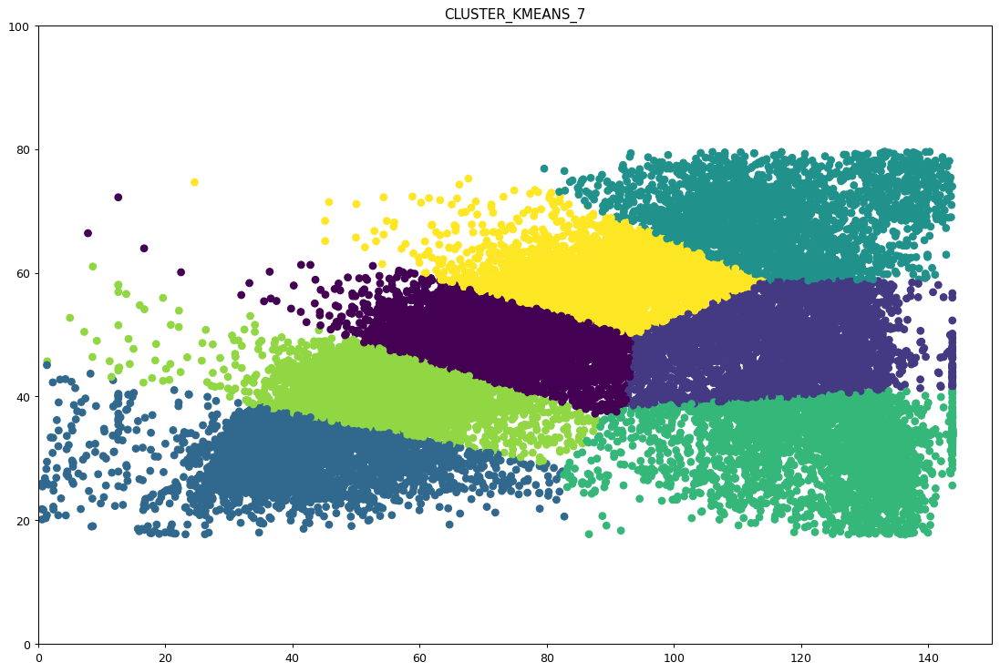

In [64]:
plot_ml_classes(df_UCS_E_clean,"cluster_kmeans_7")

Os resultados acima, mostraram que a escolha por 5 clusters ainda é razoável e pode ser uma alternativa a ser utilizada a depender de como vamos aplicar a classificação obtida, porém a rodada com 7 cluster começa a deixar a classificação um pouco mais complexa que é exatamente o que este trabalho quer evitar.

#### Hierarchy Agglomerative

In [78]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram

In [79]:
#Repetir Classificação pelo Agglomerative com 5 clusters
#df_UCS_E_clean.drop("cluster",axis=1,inplace=True)
Agglomerative_model = AgglomerativeClustering(n_clusters=5)
Agglomerative_model.fit(df_UCS_E_clean_norm)
df_UCS_E_clean['cluster_Agglomerative']=Agglomerative_model.fit_predict(df_UCS_E_clean_norm)

In [213]:
plot_ml_classes(df_UCS_E_clean,"cluster_Agglomerative")

In [81]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                      counts]).astype(float)

    # Plot the corresponding dendrogram
    plt.figure(figsize=(20,10))
    dendrogram(linkage_matrix, **kwargs)


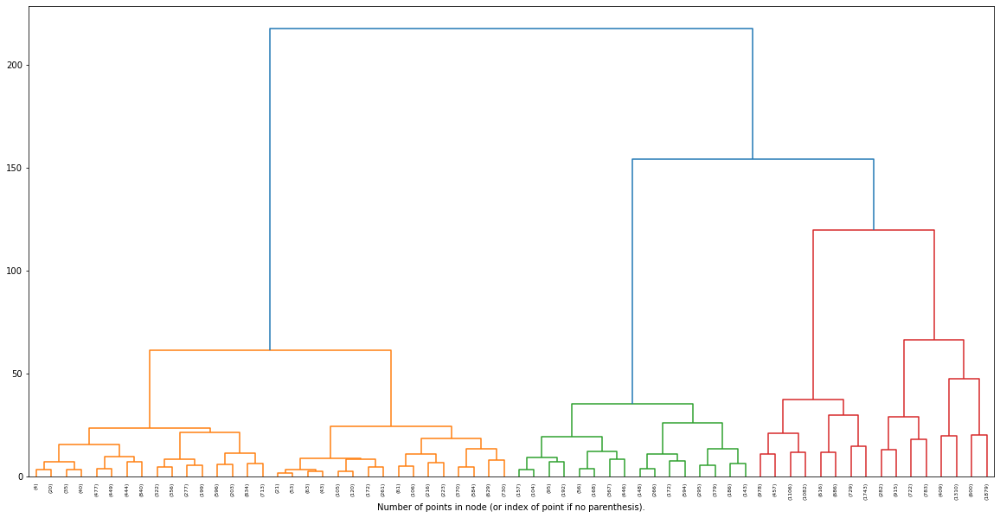

In [82]:
Agglomerative_model_2 = AgglomerativeClustering(n_clusters=None,distance_threshold=0)
Agglomerative_model_2.fit(df_UCS_E_clean_norm)

# plot the top three levels of the dendrogram
plot_dendrogram(Agglomerative_model_2, truncate_mode='level', p=5)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

#### MeanShift

In [66]:
#Repetir Classificação pelo Mean Shift com 5 clusters
from sklearn.cluster import MeanShift, estimate_bandwidth
#df_UCS_E_clean.drop("cluster",axis=1,inplace=True)

bandwidth = estimate_bandwidth(df_UCS_E_clean_norm, quantile=0.07, n_samples=5000)

ms_model = MeanShift(bandwidth=bandwidth, bin_seeding=True)
ms_model.fit(df_UCS_E_clean_norm)
df_UCS_E_clean['cluster_Mean_Shift_5']=ms_model.fit_predict(df_UCS_E_clean_norm)

In [212]:
plot_ml_classes(df_UCS_E_clean,"cluster_Mean_Shift_5")

O Algoritmo MeanShift, reconheceu de forma automatica basicamente 5 clusters, diferentemente do K-means e do Agglomerative, o Mean-Shift não requer a definição inicial da quantidade de clusters.  
Contudo vemos que as cofigurações automáticas indicam clusters/ grupos similares aos indicados pelos métodos anteriores.

#### DbScan

In [68]:
#Repetir Classificação pelo DBSCan com 4 clusters
from sklearn.cluster import DBSCAN
#df_UCS_E_clean.drop("cluster",axis=1,inplace=True)

dbscan_model = DBSCAN(eps=0.5, min_samples=5)
dbscan_model.fit(df_UCS_E_clean_norm)
df_UCS_E_clean['cluster_DBSCAN']=dbscan_model.fit_predict(df_UCS_E_clean_norm)

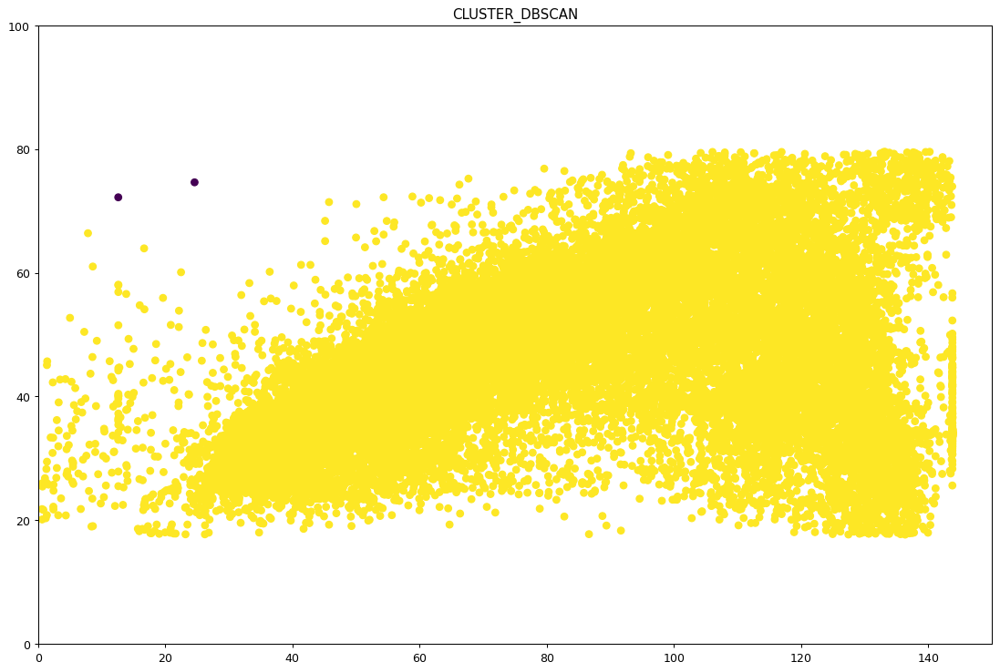

In [69]:
plot_ml_classes(df_UCS_E_clean,"cluster_DBSCAN")

O DBSCAN, aparentemente se perde e não consegue separar os dados somente com as entradas existentes. Equivale a um único grande grupo.

In [70]:
#Plotar todos os métodos em uma só figura para comparação

In [72]:
df_UCS_E_clean.head()

,E,UCS,cluster_kmeans_4,cluster_kmeans_E_GPa,cluster_kmeans_5,cluster_kmeans_7,cluster_Mean_Shift_5,cluster_DBSCAN
15243,59.137455,92.702123,3,0,3,6,2,0
15244,55.841485,74.784382,0,2,3,6,0,0
15245,50.565191,57.976112,0,2,4,0,0,0
15246,45.241004,49.463883,0,1,4,5,0,0
15284,79.002901,116.147559,3,0,1,3,2,0


In [73]:
cluster_methods = ["cluster_kmeans_4","cluster_kmeans_5","cluster_kmeans_7","cluster_Agglomerative","cluster_Mean_Shift_5","cluster_DBSCAN"]

In [76]:
a=1
f'ax{a}'

'ax1'

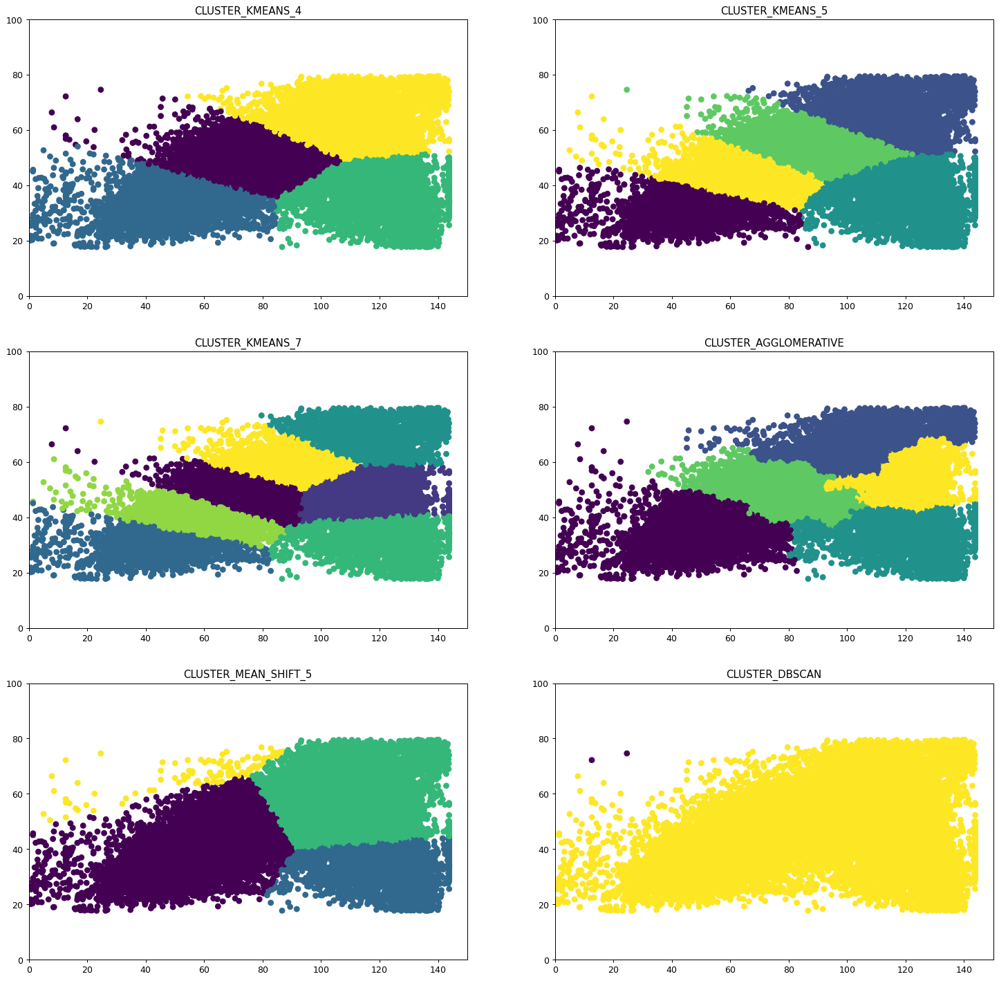

In [83]:
fig,ax = plt.subplots(nrows=3,ncols=2,figsize=(20,20),dpi=90)
ax1 = ax[0,0]
ax2 = ax[0,1]
ax3 = ax[1,0]
ax4 = ax[1,1]
ax5 = ax[2,0]
ax6 = ax[2,1]

y_lim = (0,100)
x_lim = (0,150)

for i,kind_cluster in zip(range(1,7),cluster_methods):
    a=str(kind_cluster)
    locals()[f'ax{i}'].set_title(kind_cluster.upper())
    locals()[f'ax{i}'].scatter(df_UCS_E_clean.UCS,df_UCS_E_clean.E,c=df_UCS_E_clean[a])
    locals()[f'ax{i}'].set_xlim(x_lim)
    locals()[f'ax{i}'].set_ylim(y_lim)
plt.show()

Porém ainda persiste a pergunta, qual é o método que mais se adequa ao caso.  
Como as propriedades calculadas são oriundas dos perfis elétricos, porque não utilizar os proprios perfis para calcular as classes. Aumentando assim as dimensões passives de serem analisadas. Como visualizado inicialmente os perfis não possuem um correlação franca entre si, a não ser os perfis de velocidade.

### Clusterização com todos os dados

In [241]:
df_NA_mec_ML_logs = df_NA_mec_ML[["GR","RHOB","DTCO","DTS","PHIE"]].copy()
df_NA_mec_ML_logs["VpVs"] = df_NA_mec_ML.Vp / df_NA_mec_ML.Vs
df_NA_mec_ML_logs["PR"]=df_NA_mec.PR.values
df_NA_mec_ML_logs["UCS"]=df_NA_mec.UCS.values
df_NA_mec_ML_logs["E"]=df_NA_mec.E.values / 1000 #converting to GPa

In [242]:
df_NA_mec_ML_logs.head()

,GR,RHOB,DTCO,DTS,PHIE,VpVs,PR,UCS,E
15236,36.384319,2.555471,61.273228,109.646599,0.068067,1.789470,0.272955,89.600269,50.275154
15237,41.888142,2.571426,59.804676,106.818802,0.063731,1.786128,0.271716,92.341625,53.251110
15238,38.038620,2.593175,58.100441,105.551498,0.061214,1.816707,0.282649,93.970881,55.471599
15239,32.335922,2.615031,57.108669,103.638298,0.057806,1.814756,0.281977,96.223121,57.993125
15240,28.901499,2.622700,56.841373,102.468079,0.059208,1.802702,0.277752,95.290366,59.303156


In [243]:
# df_NA_mec_ML_logs

def plot_boxes(df):
    curves2 = []
    for curve in df.columns:
        curves2.append(curve)

    fig,axes = plt.subplots(figsize=(30,7),ncols=len(curves2))
    n=0
    for i in curves2:
        sb.boxplot(y=i,data=df,ax=axes[n])
        n=n+1

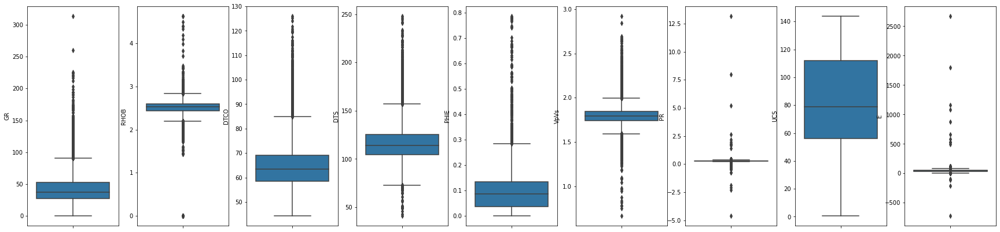

In [244]:
plot_boxes(df_NA_mec_ML_logs)

In [249]:
def clean_outliers(df):
    df_ML_clean = df.copy()
    index=[]
    for curve in df.columns:
        index = df_ML_clean[(df_ML_clean[curve]<=df_ML_clean[curve].quantile(0.02))|(df_ML_clean[curve]>= df[curve].quantile(0.98))].index
        df_ML_clean = df_ML_clean.drop(index)
    #return index
    return df_ML_clean

In [250]:
df_ML_clean = clean_outliers(df_NA_mec_ML_logs)

In [273]:
print(f'O dataset possuia: {df_NA_mec_ML_logs.shape[0]} linhas. E agora possui: {df_ML_clean.shape[0]}.')

O dataset possuia: 30219 linhas. E agora possui: 17609.


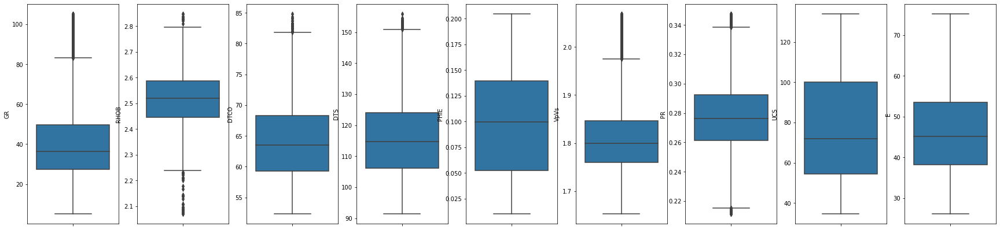

In [252]:
plot_boxes(df_ML_clean)

In [253]:
#Normalizar
# which normalization method
# zscore -> StandardScaller
# MinMax -> MinMaxScaller

from sklearn.preprocessing import StandardScaler, MinMaxScaler
zscore = StandardScaler()
MinMax = MinMaxScaler()

df_ML_clean_std = pd.DataFrame(zscore.fit_transform(df_ML_clean),columns=df_ML_clean.columns)
df_ML_clean_MinMax = pd.DataFrame(MinMax.fit_transform(df_ML_clean),columns=df_ML_clean.columns)

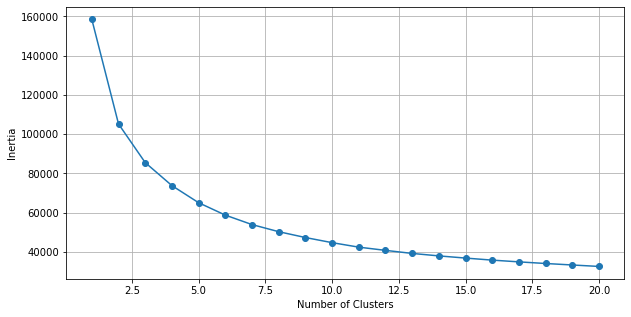

In [263]:
ml_class.k_cluster_ideal(df_ML_clean_std,20)

In [259]:
k_means_all_data = KMeans(init="k-means++",n_clusters=5,n_init=10)
k_means_all_data.fit(df_ML_clean_std)
labels = k_means_all_data.predict(df_ML_clean_std)
df_ML_clean["k_means_all_std"]=labels

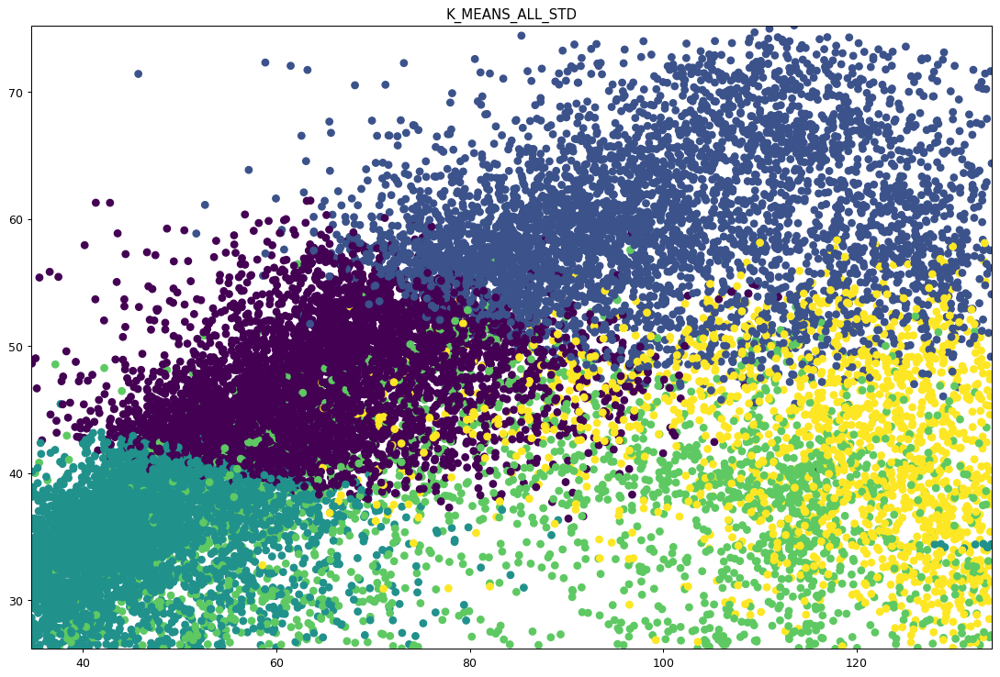

In [260]:
plot_ml_classes(df_ML_clean,"k_means_all_std")

In [406]:
fig = px.scatter_3d (df_ML_clean, x=df_ML_clean.E, y=df_ML_clean.UCS,z=df_ML_clean.VpVs,color=df_ML_clean.k_means_all_std.astype("category"), width=800, height=800)
fig.show()

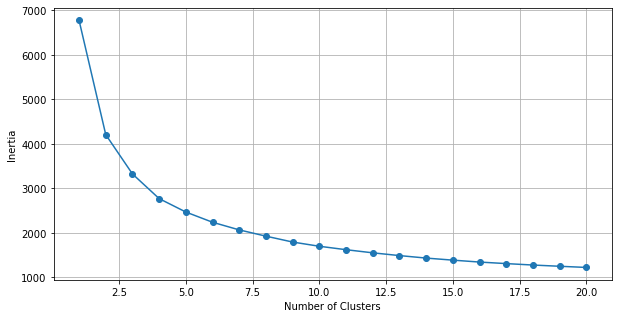

In [264]:
ml_class.k_cluster_ideal(df_ML_clean_MinMax,20)

In [266]:
k_means_all_data = KMeans(init="k-means++",n_clusters=5,n_init=10)
k_means_all_data.fit(df_ML_clean_std)
labels = k_means_all_data.predict(df_ML_clean_MinMax)
df_ML_clean["k_means_all_MinMax"]=labels

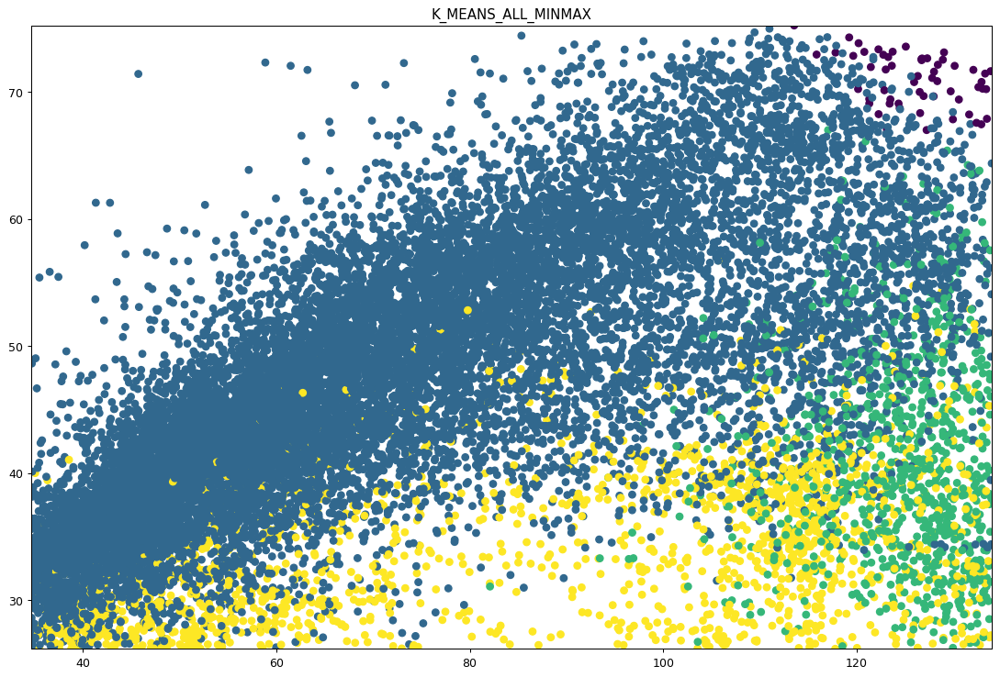

In [267]:
plot_ml_classes(df_ML_clean,"k_means_all_MinMax")

In [325]:
#from mpl_toolkits.mplot3d import Axes3D
df_ML_clean

,GR,RHOB,DTCO,DTS,PHIE,VpVs,PR,UCS,E,k_means_all,k_means_all_std,k_means_all_MinMax,cluster_tsne,cluster_pca
15292,56.579376,2.550596,68.739899,127.683403,0.018062,1.857486,0.295940,126.835518,37.671893,2,4,3,1,4
15293,48.649536,2.566347,63.144669,121.796997,0.026827,1.928856,0.316209,119.340097,42.308456,0,3,4,1,2
15294,40.611828,2.560612,58.490299,113.709396,0.032387,1.944073,0.320106,114.816648,48.575791,0,3,4,1,2
15304,43.337925,2.343534,55.820889,94.209297,0.037605,1.687707,0.229489,110.727319,60.320967,4,1,2,3,1
15305,37.560196,2.294683,58.895363,99.883400,0.072487,1.695947,0.233509,86.889398,52.715488,3,0,2,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2369,104.977753,2.586114,69.199707,122.719299,0.023713,1.773408,0.266897,121.950776,40.422500,2,4,3,1,4
2374,93.400452,2.560033,72.659798,121.435402,0.020530,1.671287,0.221169,124.678941,39.390418,2,4,3,1,4
2375,79.580231,2.571825,68.856743,117.999702,0.028257,1.713699,0.241837,118.160121,42.619085,2,4,3,1,4
2376,90.166016,2.563391,66.642982,115.600304,0.031831,1.734621,0.251109,115.260772,44.591475,2,4,3,1,4


In [400]:
%matplotlib inline
fig = px.scatter_3d (df_ML_clean, x=df_ML_clean.UCS, y=df_ML_clean.E, z=df_ML_clean.VpVs, color=df_ML_clean.k_means_all_std.astype("category"),
width=800, height=800)
fig.show()

In [399]:
%matplotlib inline
fig = px.scatter (
    df_ML_clean, x=df_ML_clean.UCS, y=df_ML_clean.E, color=df_ML_clean.k_means_all_std.astype("category"),
width=800, height=800)
fig.show()

### Applying TSN-E

In [351]:
#import plotly.express as px

In [353]:
tsne_model_2 = TSNE(n_components=2,perplexity=50)
tsne_result_2 = tsne_model_2.fit_transform(df_ML_clean_std)
tsne_result_2.shape

(17609, 2)

In [398]:
fig = px.scatter (tsne_result_2, x=0, y=1,color=df_ML_clean.cluster_tsne.astype("category"), width=800, height=800)
fig.show()

In [338]:
from sklearn.manifold import TSNE
tsne_model = TSNE(n_components=3,perplexity=100)
tsne_result = tsne_model.fit_transform(df_ML_clean_std)
tsne_result.shape

(17609, 3)

In [402]:
fig = px.scatter_3d (tsne_result, x=0, y=1,z=2,color=df_ML_clean.cluster_tsne.astype("category"), width=800, height=800)
fig.show()

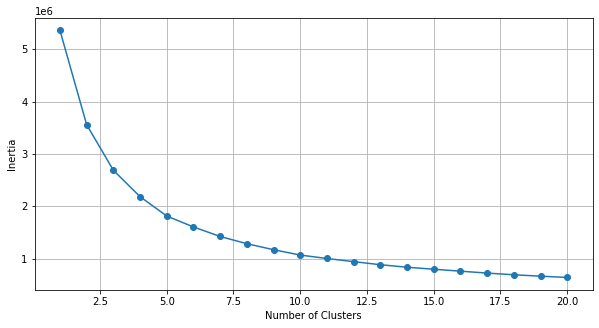

In [295]:
ml_class.k_cluster_ideal(tsne_result,20)

In [292]:
k_means_tsne = KMeans(init="k-means++",n_clusters=5,n_init=10)
k_means_tsne.fit(tsne_result)
df_ML_clean['cluster_tsne']=k_means_tsne.predict(tsne_result)

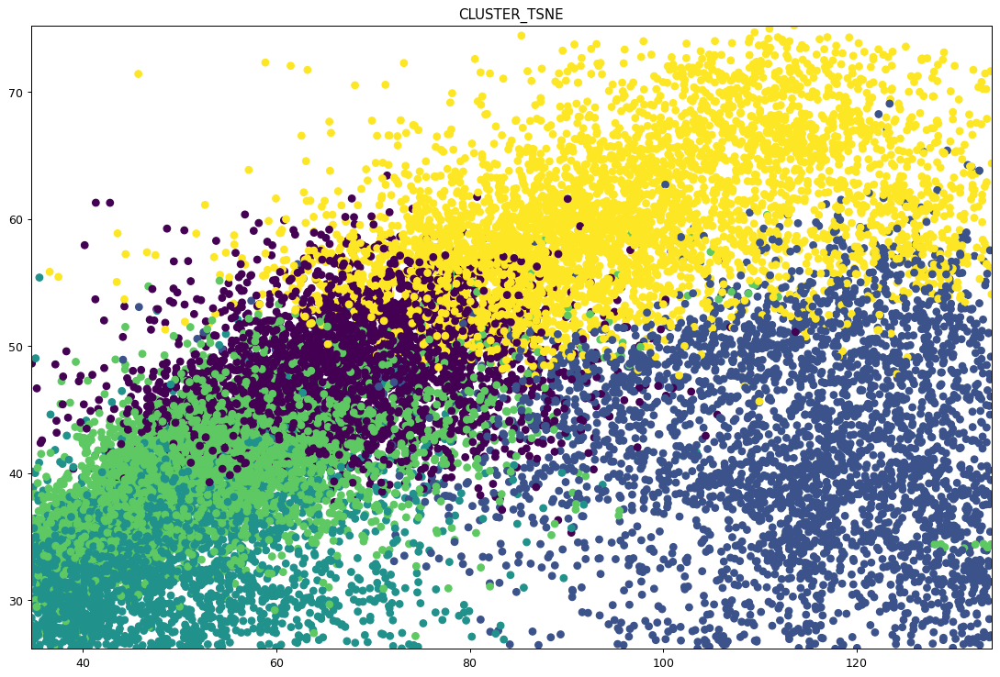

In [293]:
plot_ml_classes(df_ML_clean,"cluster_tsne")

In [407]:
fig = px.scatter_3d (df_ML_clean, x="UCS", y="E",z="VpVs",color=df_ML_clean.cluster_tsne.astype("category"), width=800, height=800)
fig.show()

### Applying PCA

In [356]:
len(df_ML_clean_std.columns)

9

In [359]:
from sklearn.decomposition import PCA
pca_model = PCA(n_components=9)
pca_result = pca_model.fit_transform(df_ML_clean_std)
pca_result.shape

array([4.94499999e-01, 2.39402776e-01, 1.69227393e-01, 6.12317557e-02,
       3.08699227e-02, 2.54772224e-03, 1.16756521e-03, 9.92640192e-04,
       6.02257530e-05])

In [363]:
# Identificando a quantidade de variáveis que melhor explicam a variabilidade do conjunto de dados
pca_model.explained_variance_ratio_

array([4.94499999e-01, 2.39402776e-01, 1.69227393e-01, 6.12317557e-02,
       3.08699227e-02, 2.54772224e-03, 1.16756521e-03, 9.92640192e-04,
       6.02257530e-05])

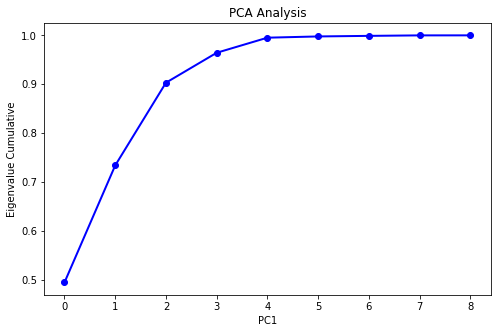

In [367]:
fig = plt.figure(figsize=(8,5))
plt.plot(pca_model.explained_variance_ratio_.cumsum(),"bo-",linewidth = 2)
plt.title("PCA Analysis")
plt.xlabel("PC1")
plt.ylabel("Eigenvalue Cumulative")
plt.show()

In [380]:
pca_comp = pca_model.components_[0,:]
df_columns = df_ML_clean_std.columns
def get_important_values_PCA(pca_components_= pca_comp, df_columns=df_columns):
    df = pd.DataFrame()
    df["Vars"] = df_columns
    df["PC1"] = pca_comp
    df["PC1"] = df.PC1.abs()
    df.sort_values(by="PC1",ascending=False,inplace=True)
    return df

get_important_values_PCA()

,Vars,PC1
8,E,0.440232
3,DTS,0.418646
2,DTCO,0.396265
1,RHOB,0.390649
4,PHIE,0.358607
7,UCS,0.339472
5,VpVs,0.181399
6,PR,0.180033
0,GR,0.110182


Análise PCA nos mostra que 3 componentes principais explicam mais de 90% da variabilidade do dataset.  
Portanto, pode esse parêmetro como otimizador.

Já analisando quais as variaveis tiveram mais peso nos resultados, observa-se que Gamma Ray, Poisson Ratio e Razão VpVs, possuem pesos menores de 20%, enquanto as demais estão entre 30-45%, o que não evidência o controle unico de apenas uma variável.

In [381]:
#Aplicando PCA reduzindo para 3 componentes
pca_model = PCA(n_components=3)
pca_result = pca_model.fit_transform(df_ML_clean_std)
pca_result.shape

(17609, 3)

In [404]:
fig = px.scatter_3d (pca_result, x=0, y=1,z=2 ,color=df_ML_clean.cluster_pca.astype("category"), width=800, height=800)
fig.show()

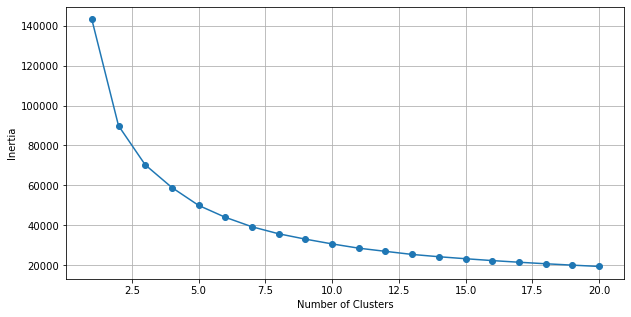

In [306]:
ml_class.k_cluster_ideal(pca_result,20)

In [382]:
k_means_pca = KMeans(init="k-means++",n_clusters=5,n_init=10)
k_means_pca.fit(pca_result)
df_ML_clean['cluster_pca']=k_means_pca.predict(pca_result)

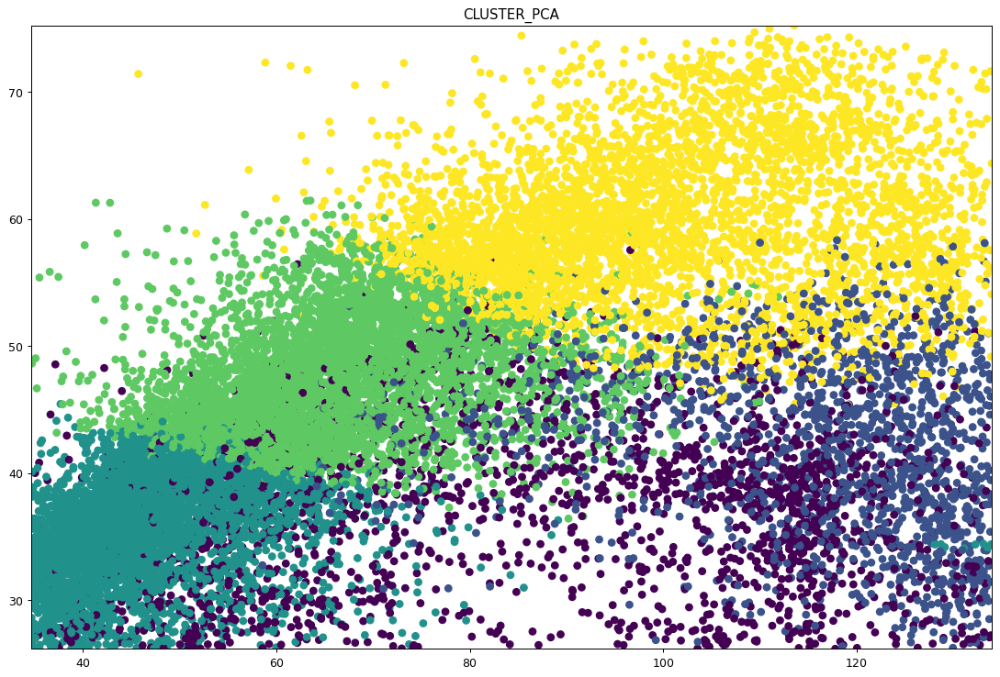

In [383]:
plot_ml_classes(df_ML_clean,"cluster_pca")

In [405]:
fig = px.scatter_3d (df_ML_clean, x="E", y="UCS",z="VpVs",color=df_ML_clean.cluster_pca.astype("category"), width=800, height=800)
fig.show()

In [395]:
fig = px.scatter_3d (pca_result, x=0, y=1,z=2,color=df_ML_clean.cluster_pca,width=800, height=800)
fig.show()